<a href="https://colab.research.google.com/github/ayushs0911/OpenCV/blob/main/Basics_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

In [2]:
!wget https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
!unzip -qq images.zip

--2023-05-10 10:49:29--  https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
Resolving moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)... 52.95.148.82
Connecting to moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)|52.95.148.82|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 29586716 (28M) [application/zip]
Saving to: ‘images.zip’

images.zip          100%[===================>]  28.22M  18.8MB/s    in 1.5s    

2023-05-10 10:49:32 (18.8 MB/s) - ‘images.zip’ saved [29586716/29586716]



#Loading Displaying Saving

In [5]:
image = cv2.imread("/content/images/castara.jpeg")

In [4]:
#simple function to display images 
def imshow(title = "", image = None):
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.show()

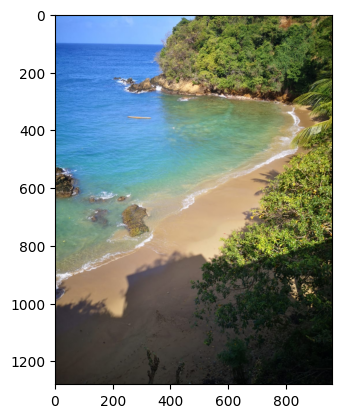

In [6]:
imshow("Title", image)

In [7]:
cv2.imwrite('output.jpg', image)

True

In [9]:
image.shape

(1280, 960, 3)

#Grayscaling

In [13]:
# Define our imshow function 
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio,size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()


In [19]:
flowers = cv2.imread("/content/images/flowers.jpeg")

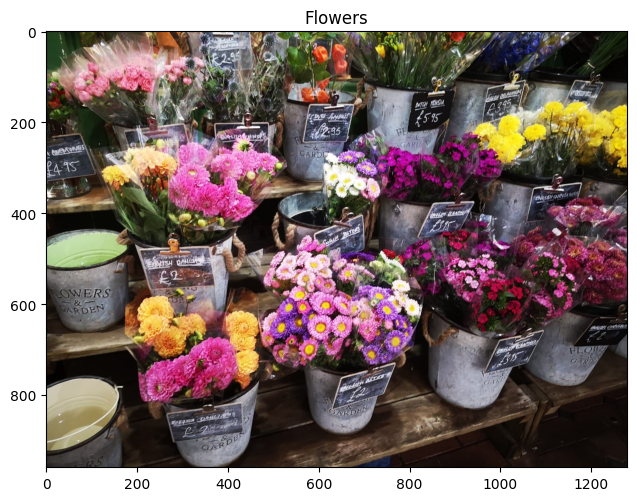

In [20]:
imshow("Flowers", flowers)

In [23]:
gray_image = cv2.cvtColor(flowers, cv2.COLOR_BGR2GRAY)

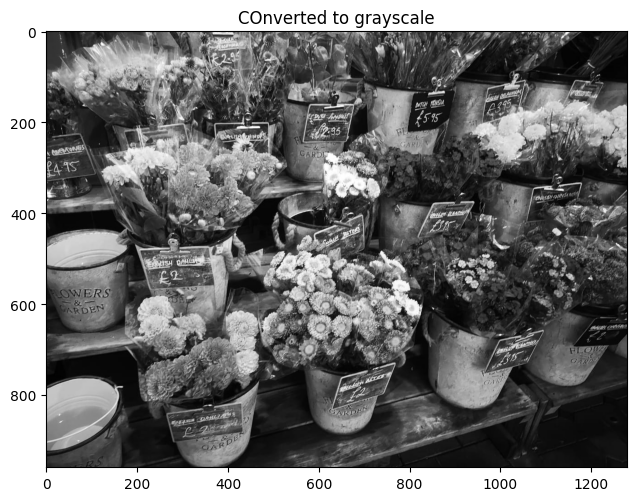

In [24]:
imshow("COnverted to grayscale", gray_image)

Grayscale just have 1 dimension, which is the intensity of gray. 

In [25]:
gray_image.shape

(960, 1280)

# Color Spaces

In [26]:
image = cv2.imread("/content/images/castara.jpeg")

To get each color space : `cv2.split`

In [27]:
B, G, R = cv2.split(image)

In [29]:
B.shape, G.shape, R.shape

((1280, 960), (1280, 960), (1280, 960))

Each color space on it's on will look like a grayscale as it lacks the other color channels


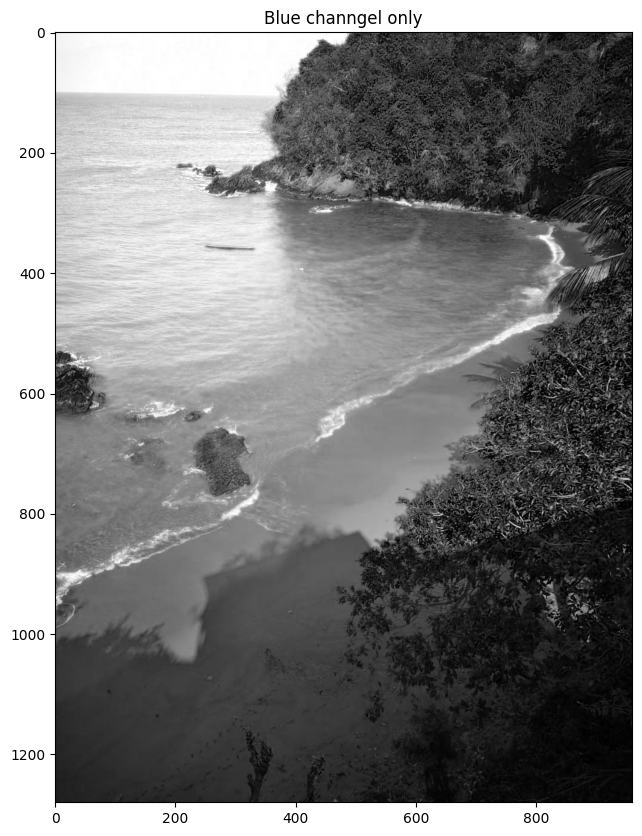

In [30]:
imshow("Blue channgel only", B)

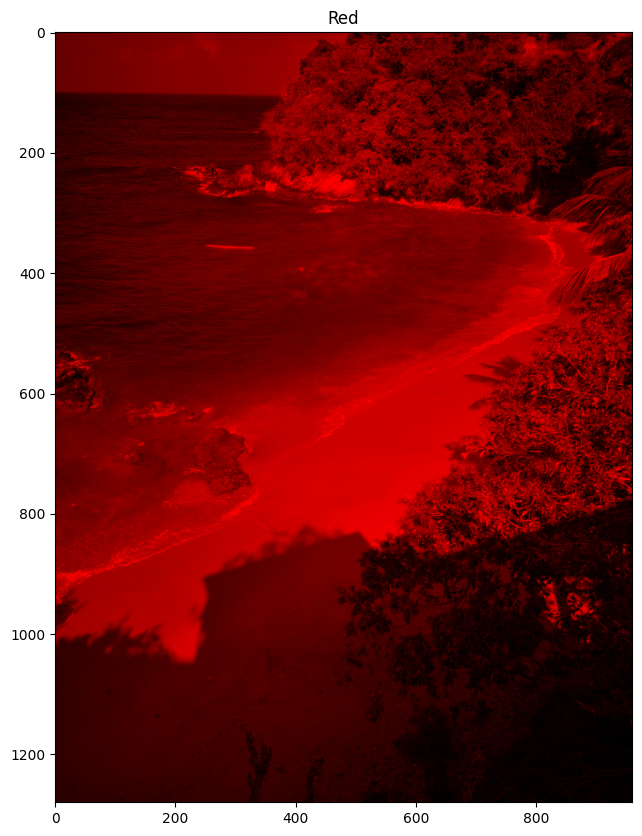

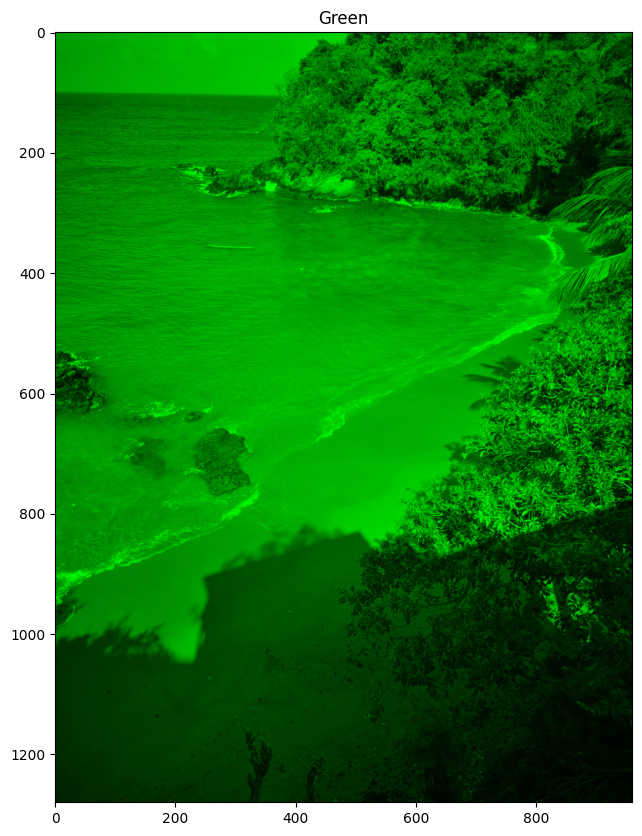

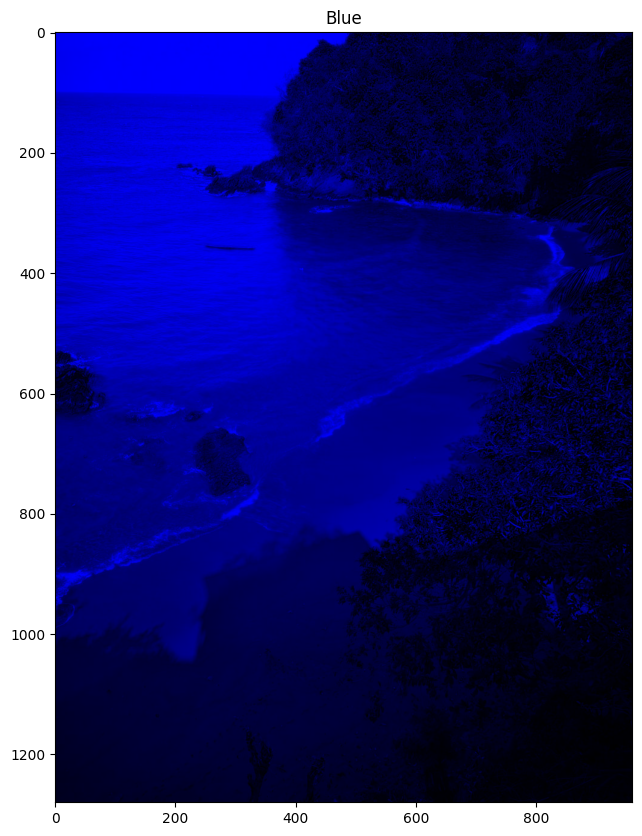

In [33]:
import numpy as np

# Let's create a matrix of zeros 
# with dimensions of the image h x w  
zeros = np.zeros(image.shape[:2], dtype = "uint8")
imshow("Red", cv2.merge([zeros, zeros, R]))
imshow("Green", cv2.merge([zeros, G, zeros]))
imshow("Blue", cv2.merge([B, zeros, zeros]))

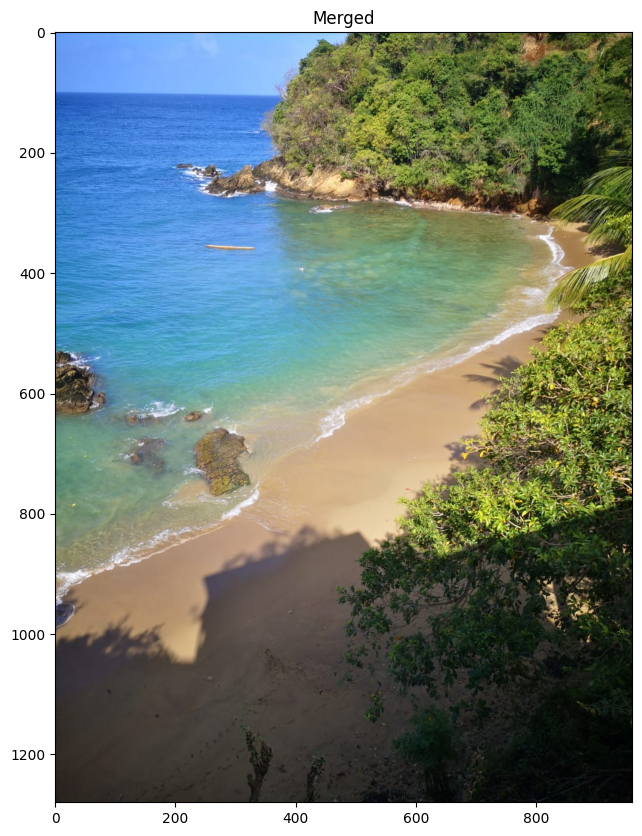

In [34]:
merged = cv2.merge([B, G, R])
imshow("Merged", merged)

We can amplify individual colors 

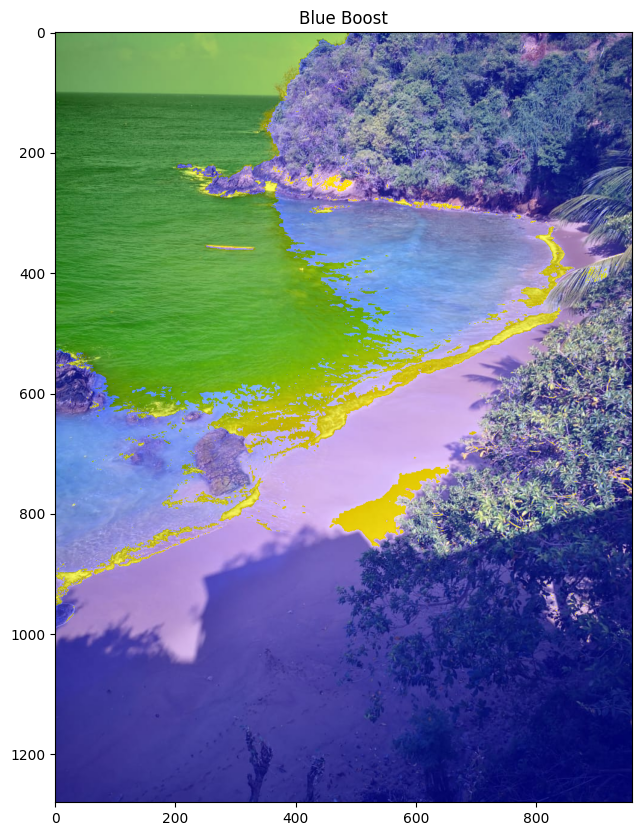

In [35]:
merged = cv2.merge([B+100, G, R])
imshow("Blue Boost", merged)

### HSV Color space

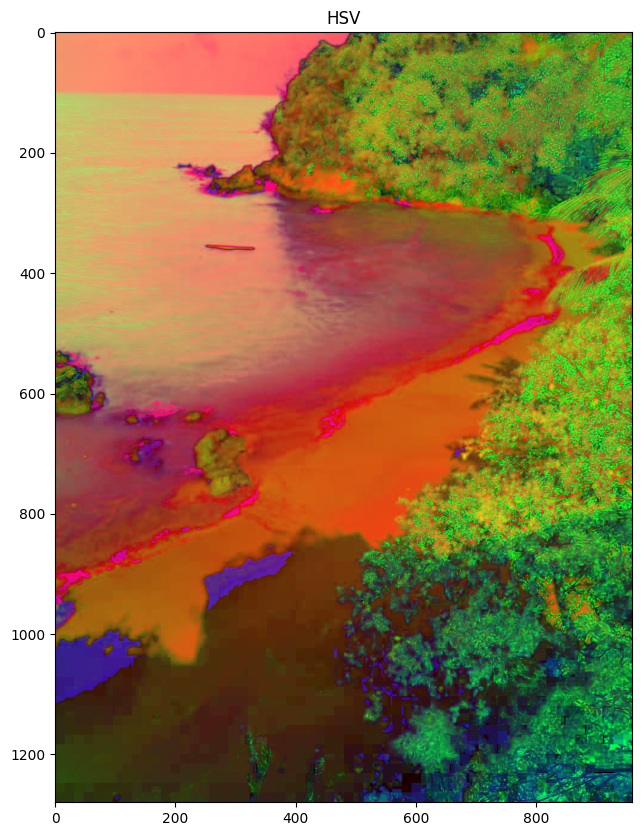

In [36]:
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
imshow('HSV', hsv_image)

**This looks odd because our plotting function was designed for RGB only images, not HSV**

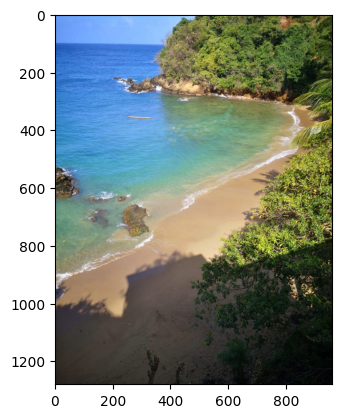

In [39]:
plt.imshow(cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB))

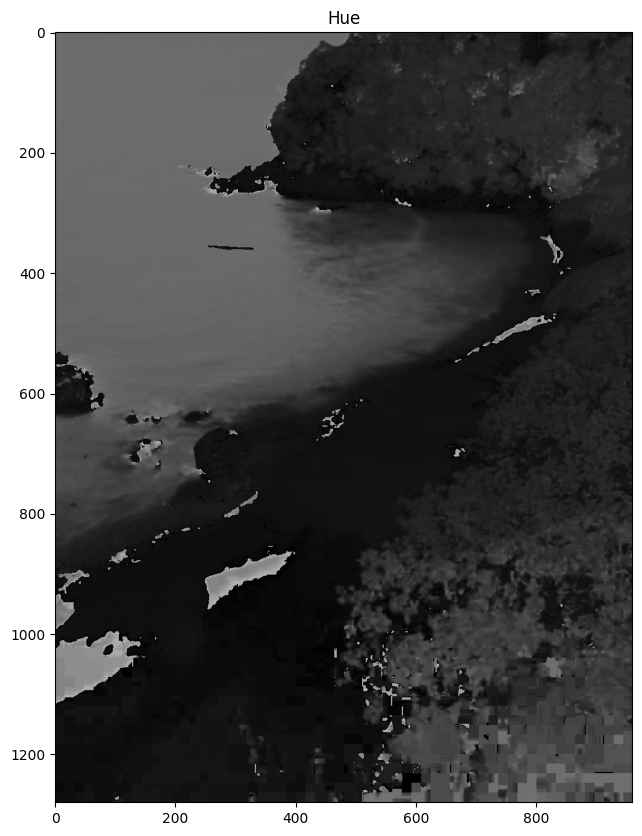

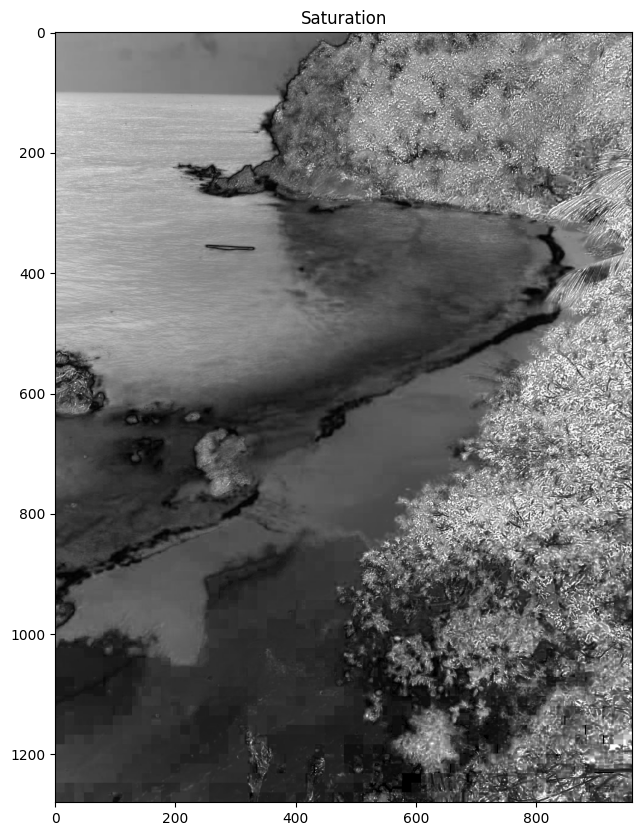

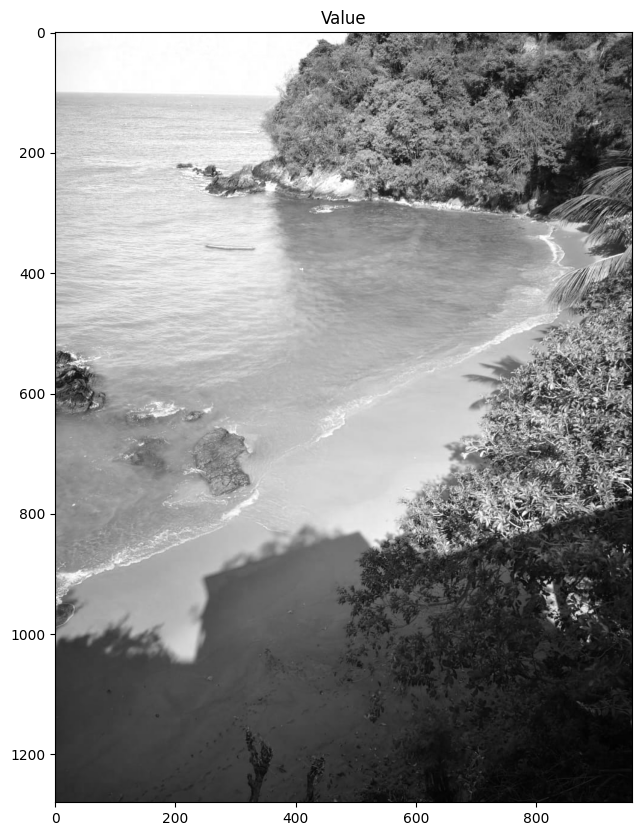

In [40]:
# Switching back to viewing the RGB representation
imshow("Hue", hsv_image[:, :, 0])
imshow("Saturation", hsv_image[:, :, 1])
imshow("Value", hsv_image[:, :, 2])

# Drawing on images

Creating a black image using numpy

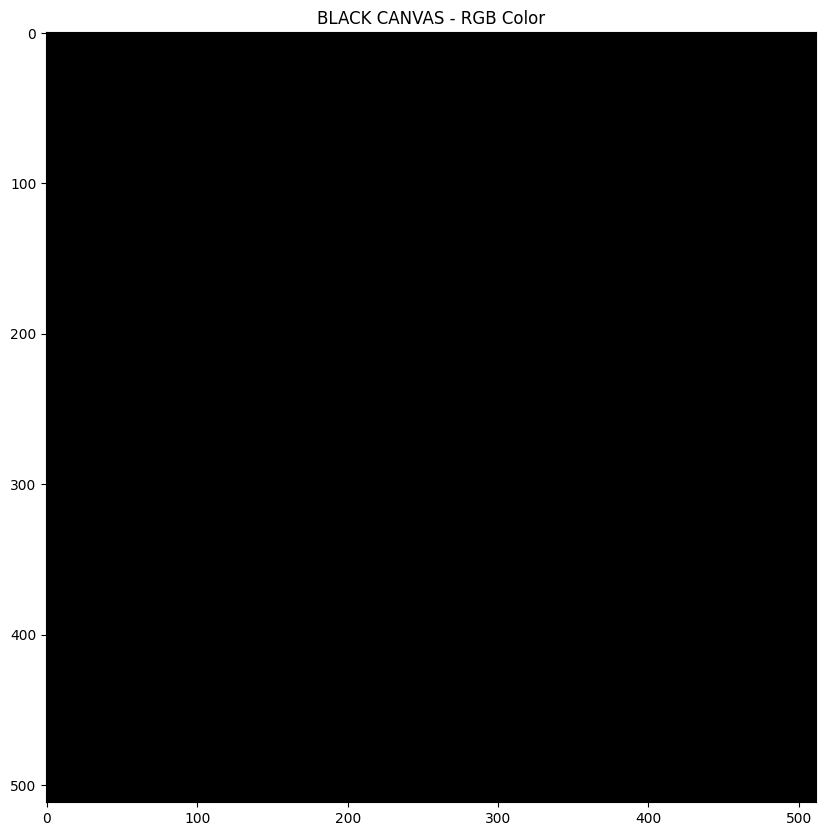

In [41]:
black = np.zeros((512, 512, 3), np.uint8)
imshow("BLACK CANVAS - RGB Color", black)

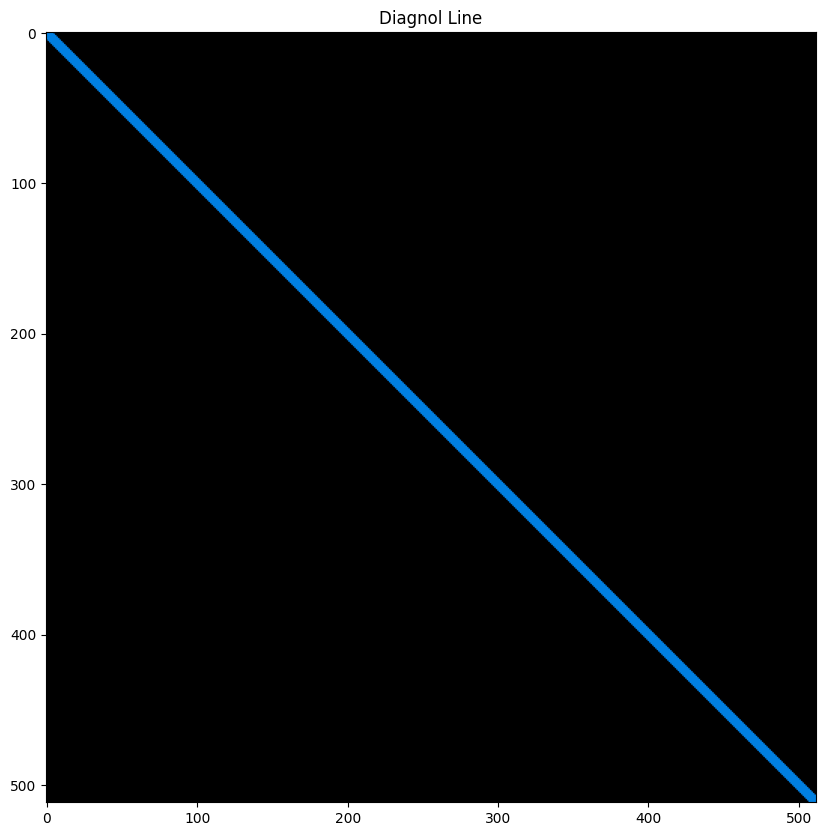

In [42]:
#line on black square 
#this is an inplace operation, it changes the input image 

cv2.line(black, (0,0), (511,511), (225,127,0), 5)
imshow("Diagnol Line", black)

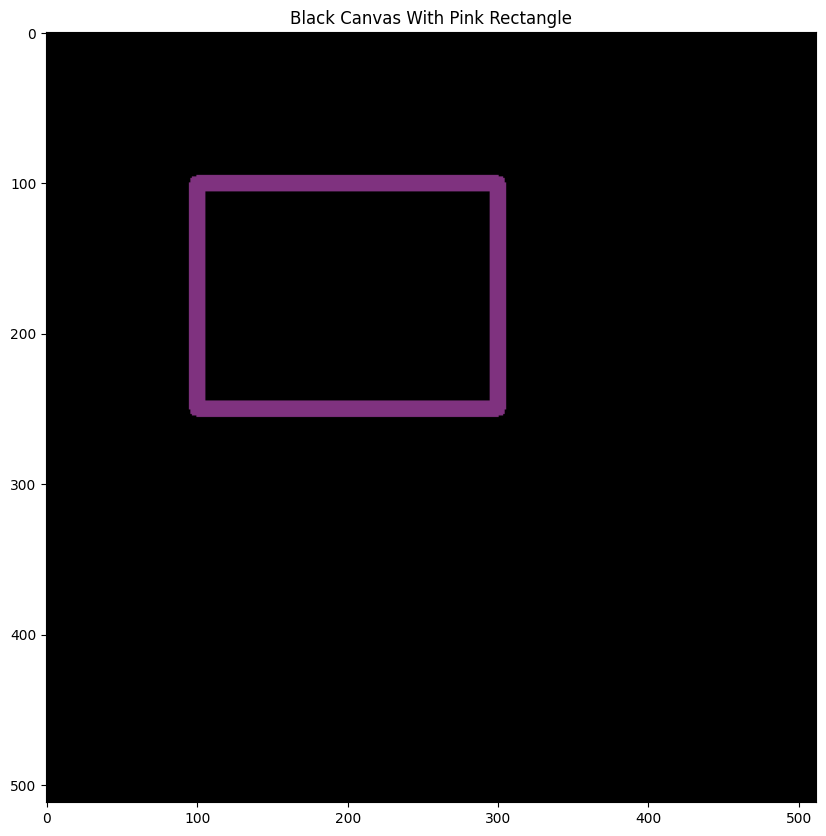

In [43]:
# Create our black canvas again because now it has a line in it
black = np.zeros((512,512,3), np.uint8)

# Thickness - if positive. Negative thickness means that it is filled
cv2.rectangle(black, (100,100), (300,250), (127,50,127), 10)
imshow("Black Canvas With Pink Rectangle", black)

```cv2.cirlce(image, center, radius, color, fill)```

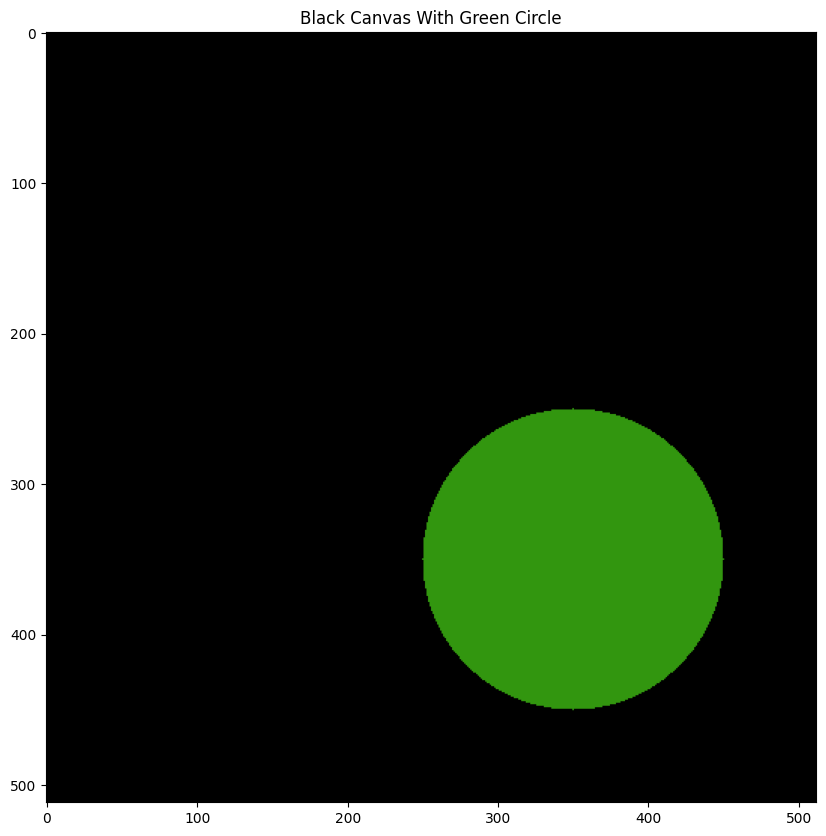

In [44]:
black = np.zeros((512,512,3), np.uint8)

cv2.circle(black, (350, 350), 100, (15,150,50), -1) 
imshow("Black Canvas With Green Circle", black)

```cv2.polylines(image, points, Closed?, color, thickness)```

if Closed = True, we join the first and last points.

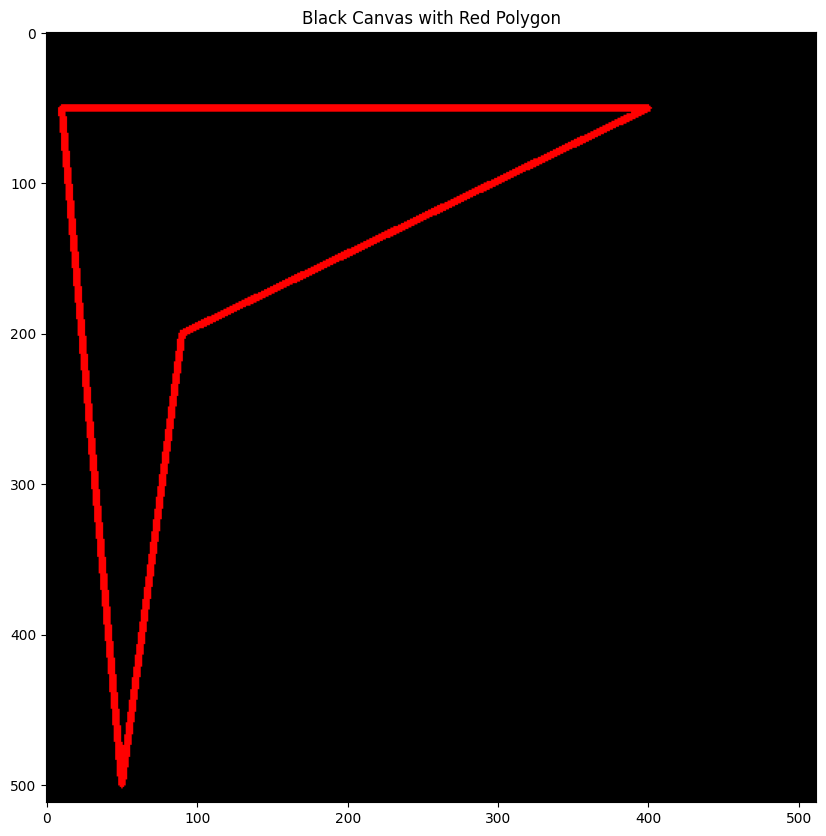

In [45]:
image = np.zeros((512,512,3), np.uint8)

# Let's define four points
pts = np.array( [[10,50], [400,50], [90,200], [50,500]], np.int32)

# Let's now reshape our points in form  required by polylines
pts = pts.reshape((-1,1,2))

cv2.polylines(image, [pts], True, (0,0,255), 3)
imshow("Black Canvas with Red Polygon", image)

### Adding text
```cv2.putText(image, 'Text to Display', bottom left starting point, Font, Font Size, Color, Thickness)```

**Available Fonts**
- FONT_HERSHEY_SIMPLEX, FONT_HERSHEY_PLAIN
- FONT_HERSHEY_DUPLEX,FONT_HERSHEY_COMPLEX 
- FONT_HERSHEY_TRIPLEX, FONT_HERSHEY_COMPLEX_SMALL
- FONT_HERSHEY_SCRIPT_SIMPLEX
- FONT_HERSHEY_SCRIPT_COMPLEX

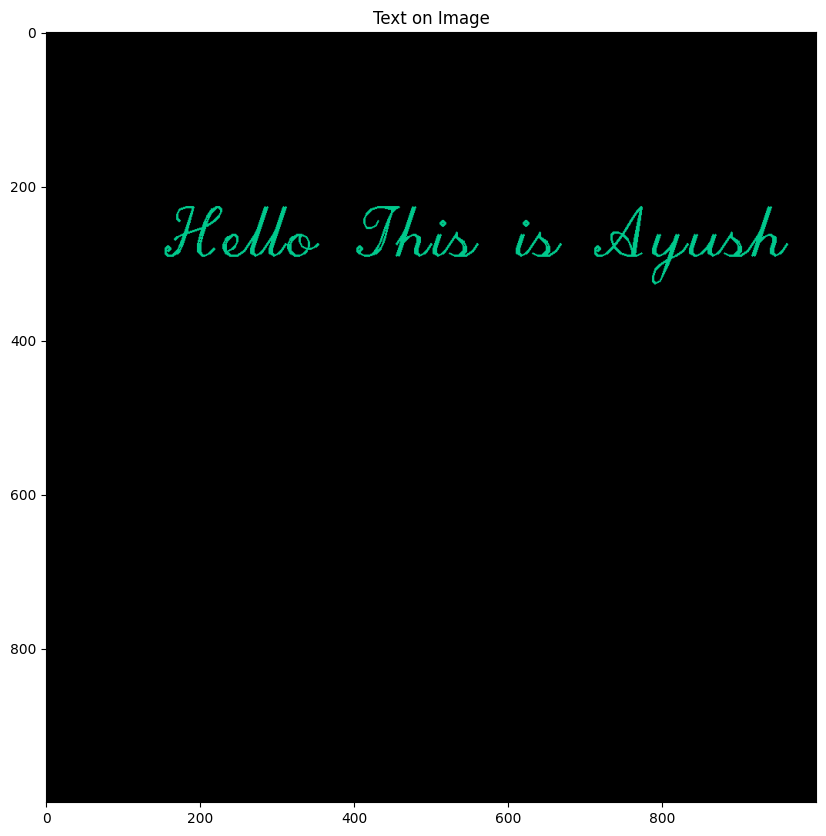

In [48]:
image = np.zeros((1000,1000,3), np.uint8)
ourString =  'Hello This is Ayush !'
cv2.putText(image, ourString, (155,290), cv2.FONT_HERSHEY_SCRIPT_COMPLEX, 3, (140,200,0), 2)
imshow("Text on Image", image)

#Translations and Rotations 

Using 
```
cv2.warpAffine(image, T, (width, height))
```
to implement these transformations. 

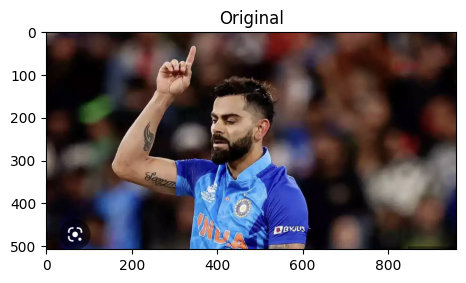

In [50]:
kohli = cv2.imread("/content/Kohli.png")
imshow("Original", kohli)


In [51]:
#storing height and width of the imahe 
height, width = image.shape[:2]

#we shift it by quarter of height and width 
quarter_height, quarter_width = height/4, width/4

In [52]:
# Translation matrix 
T = np.float32([[1, 0, quarter_width], [0, 1, quarter_height]])

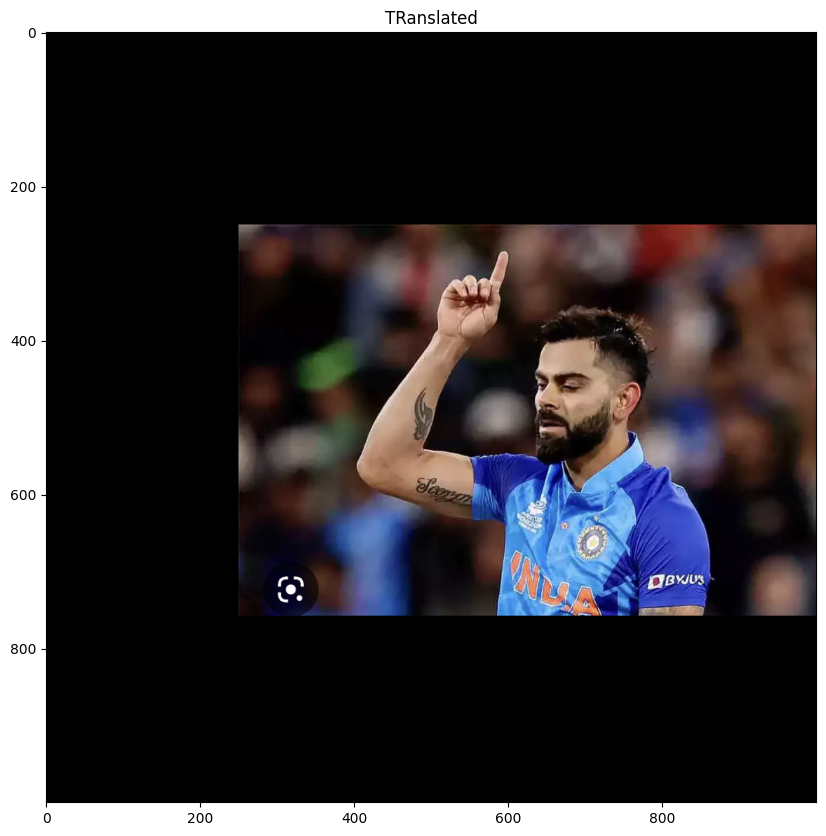

In [58]:
img_translation = cv2.warpAffine(kohli, T, (width, height))
imshow("TRanslated", img_translation)

In [55]:
print(T)

[[  1.   0. 250.]
 [  0.   1. 250.]]


In [56]:
print(height, width)

1000 1000


Using 
```
cv2.getRotationMatrix2D( 
rotation_center_x, 
rotation_center_y, 
angle of rotation, 
scale
)
```
For **Rotations**. 

In [59]:
#divide by 2 to rotate the image around its center
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), 90, 1)

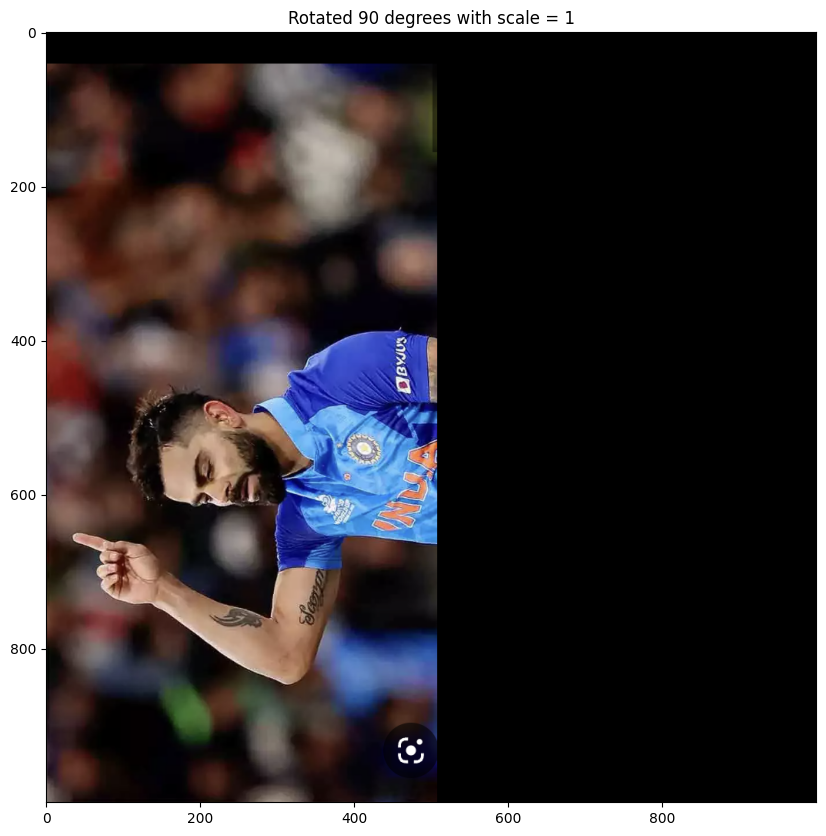

In [60]:
rotated_image = cv2.warpAffine(kohli, rotation_matrix, (width, height))
imshow("Rotated 90 degrees with scale = 1", rotated_image)

[[ 3.061617e-17  5.000000e-01  2.500000e+02]
 [-5.000000e-01  3.061617e-17  7.500000e+02]]


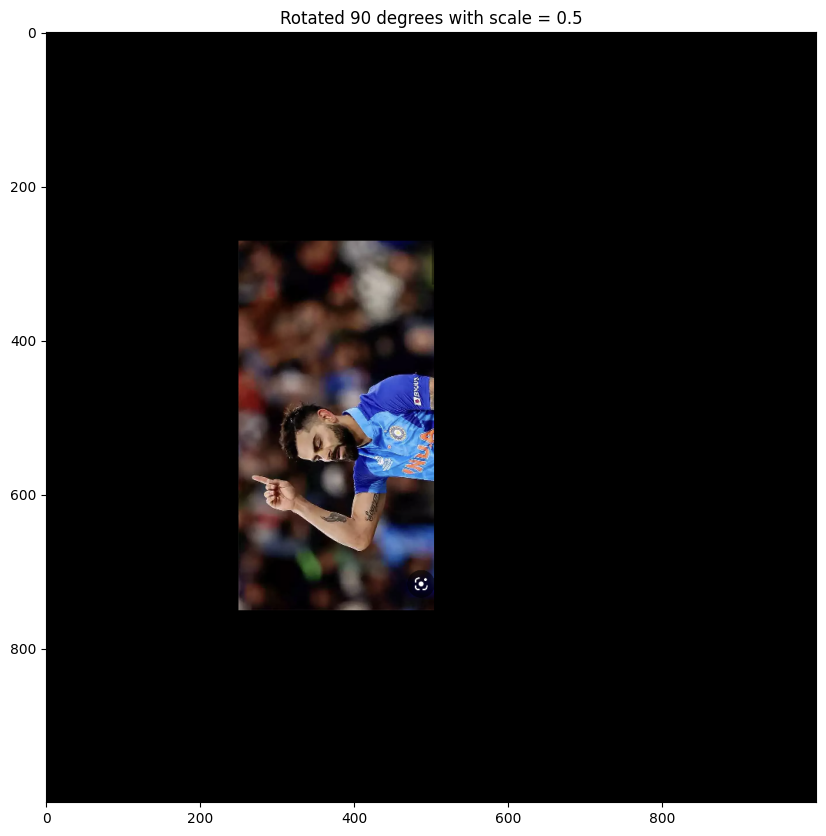

In [61]:
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), 90, 0.5)
print(rotation_matrix)
# Input our image, the rotation matrix and our desired final width and height
rotated_image = cv2.warpAffine(kohli, rotation_matrix, (width, height))
imshow("Rotated 90 degrees with scale = 0.5", rotated_image)

### `cv2.transpose()`

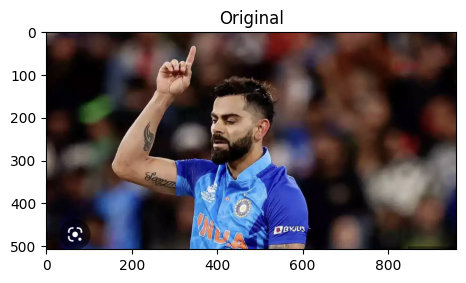

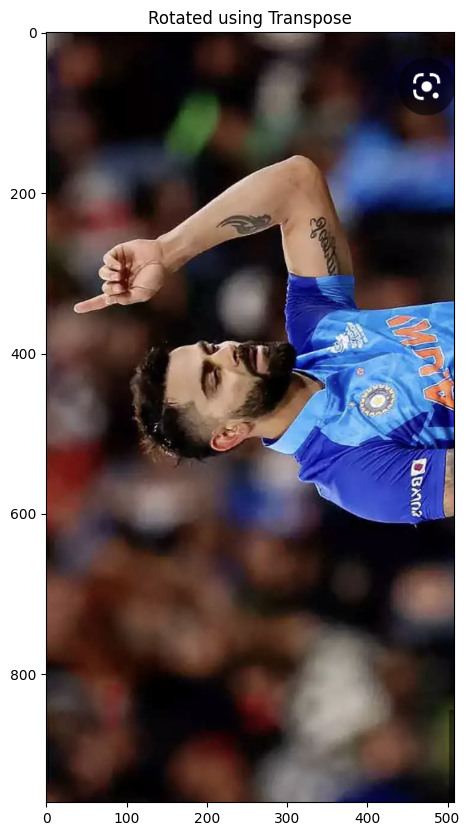

In [62]:
rotated_image = cv2.transpose(kohli)
imshow("Original", kohli)
imshow("Rotated using Transpose", rotated_image)

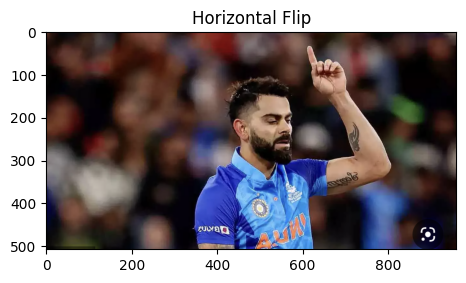

In [63]:
# Let's now to a horizontal flip.
flipped = cv2.flip(kohli, 1)
imshow("Horizontal Flip", flipped)

#Scaling, Re-Sizing, Interpolations and Cropping. 

**Re-sizing** : changing the height and width <br>
**Scaling** : changing the size, but keeping the width to height ratio constant, hence no distortions/skewing
*********
Resizing is executed using `cv2.resize()` function, 
```
cv2.resize(image, 
          dsize(output image size),
          x scale, 
          y scale, 
          interpolation)
```
**List of interpolation methods**

- cv2.INTER_AREA - Good for shrinking or down sampling
- cv2.INTER_NEAREST - Fastest
- cv2.INTER_LINEAR - Good for zooming or up sampling (default)
- cv2.INTER_CUBIC - Better
- cv2.INTER_LANCZOS4 - Best

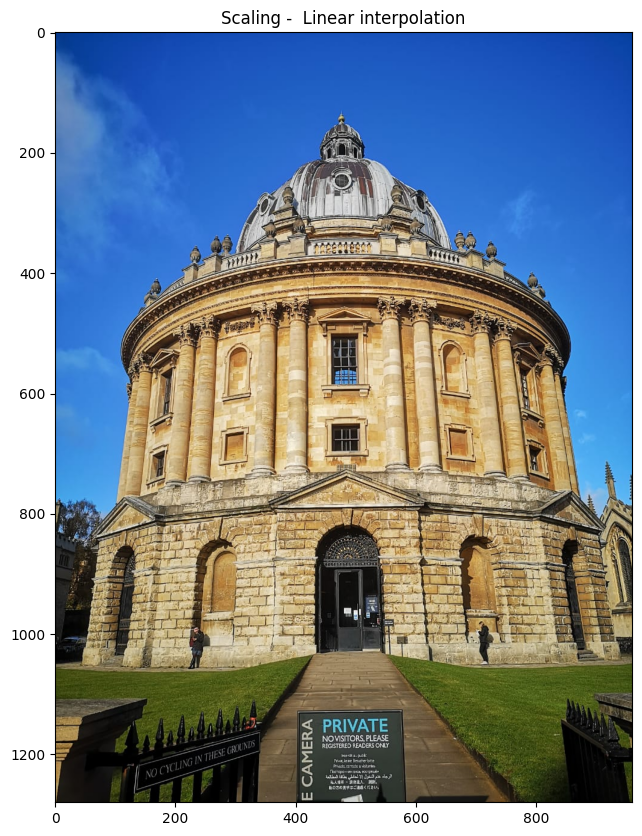

In [64]:
image = cv2.imread("/content/images/oxfordlibrary.jpeg")
imshow("Scaling -  Linear interpolation", image)

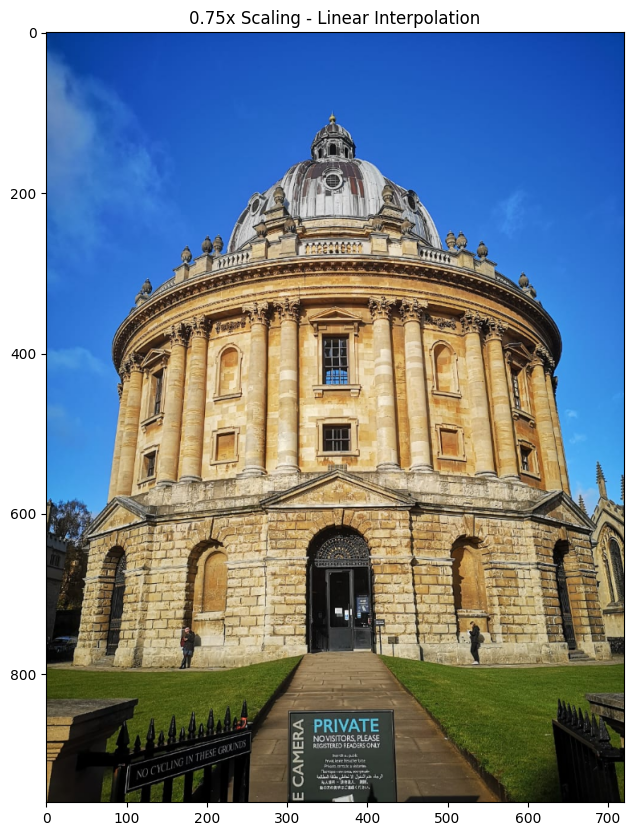

In [65]:
#if no interpolation is specified cv.INTER_LINEAR is used as defaukt 
# let's make our image 3/4 of its original size 
image_scaled = cv2.resize(image, None, fx = 0.75, fy =0.75)
imshow("0.75x Scaling - Linear Interpolation", image_scaled)

In [68]:
image_scaled.shape

(960, 720, 3)

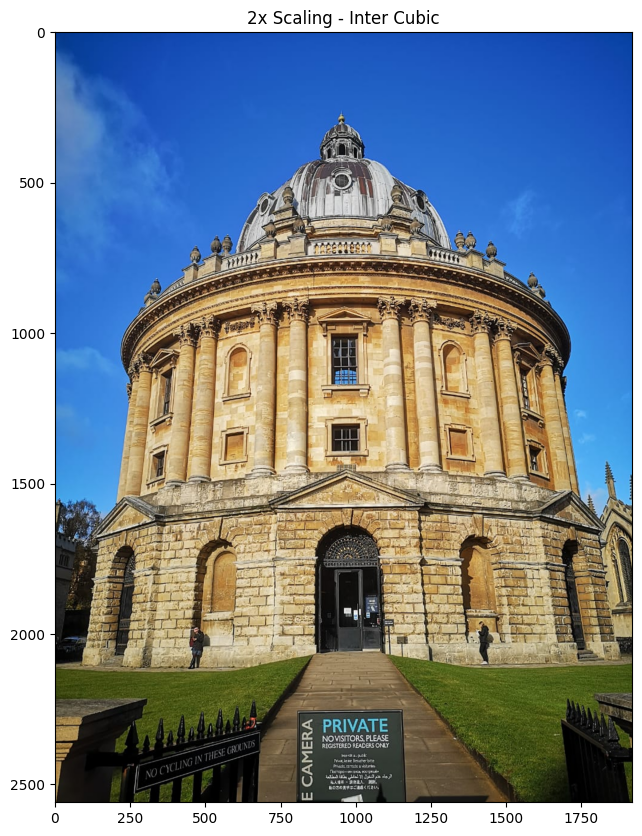

In [69]:
# Let's double the size of our image
img_scaled2 = cv2.resize(image, None, fx=2, fy=2, interpolation = cv2.INTER_CUBIC)
imshow("2x Scaling - Inter Cubic", img_scaled2)

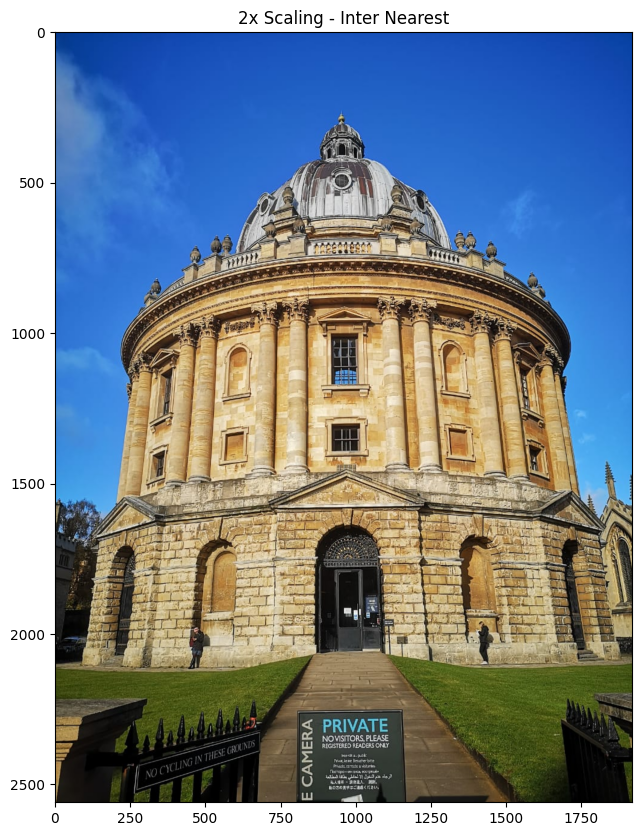

In [70]:
# Let's double the size of our image using inter_nearest interpolation
img_scaled3 = cv2.resize(image, None, fx=2, fy=2, interpolation = cv2.INTER_NEAREST)
imshow("2x Scaling - Inter Nearest", img_scaled3)

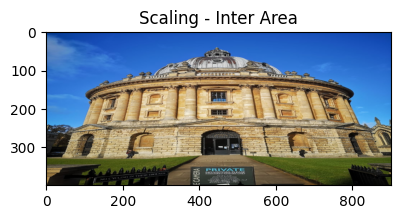

In [71]:
# Let's skew the re-sizing by setting exact dimensions
img_scaled4 = cv2.resize(image, (900, 400), interpolation = cv2.INTER_AREA)
imshow("Scaling - Inter Area", img_scaled4)

### Image Pyramids

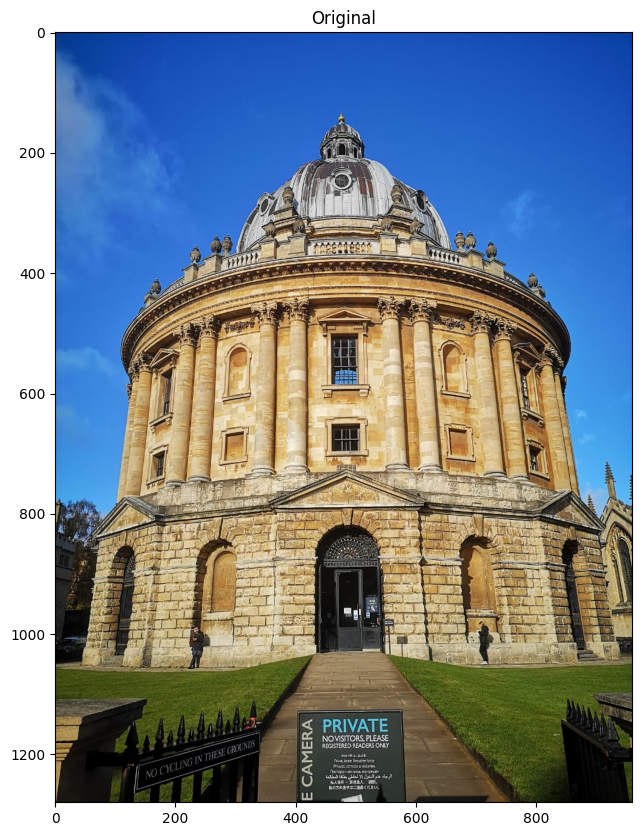

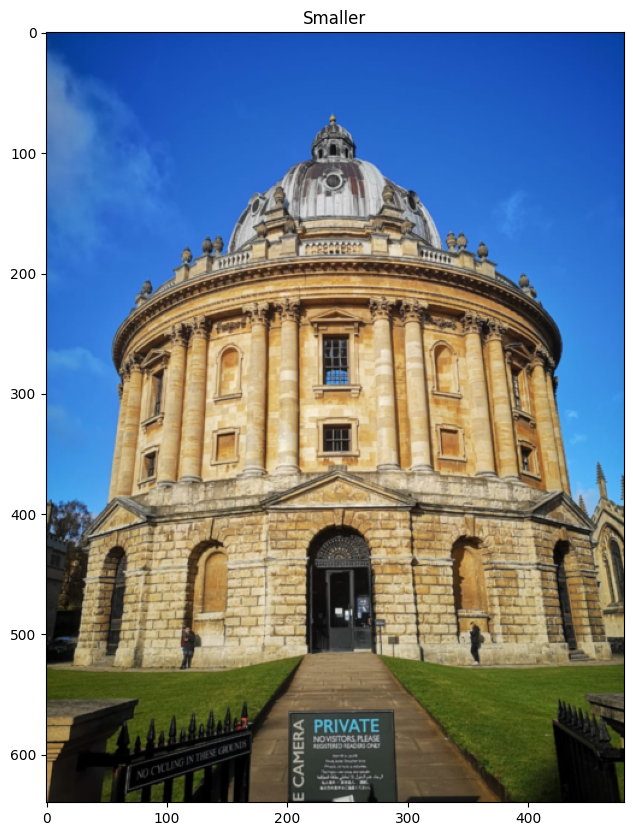

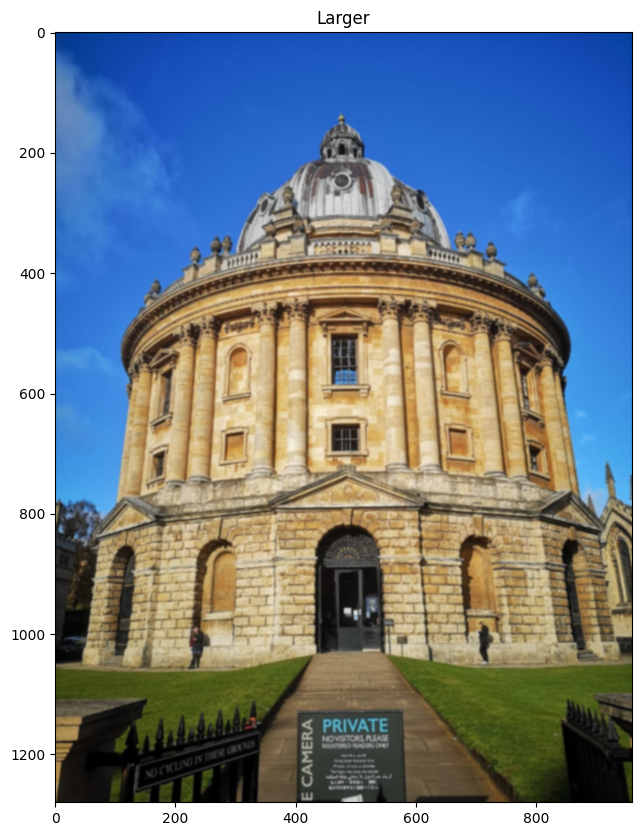

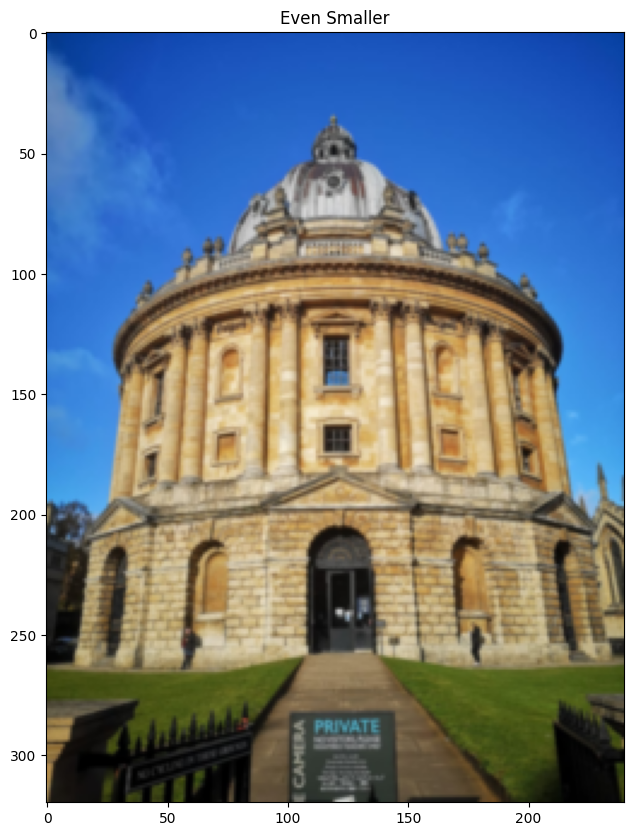

In [72]:
smaller = cv2.pyrDown(image)
larger = cv2.pyrUp(smaller)

imshow("Original", image)
imshow('Smaller', smaller)
imshow('Larger', larger)

even_smaller = cv2.pyrDown(smaller)
imshow('Even Smaller', even_smaller)

### Cropping

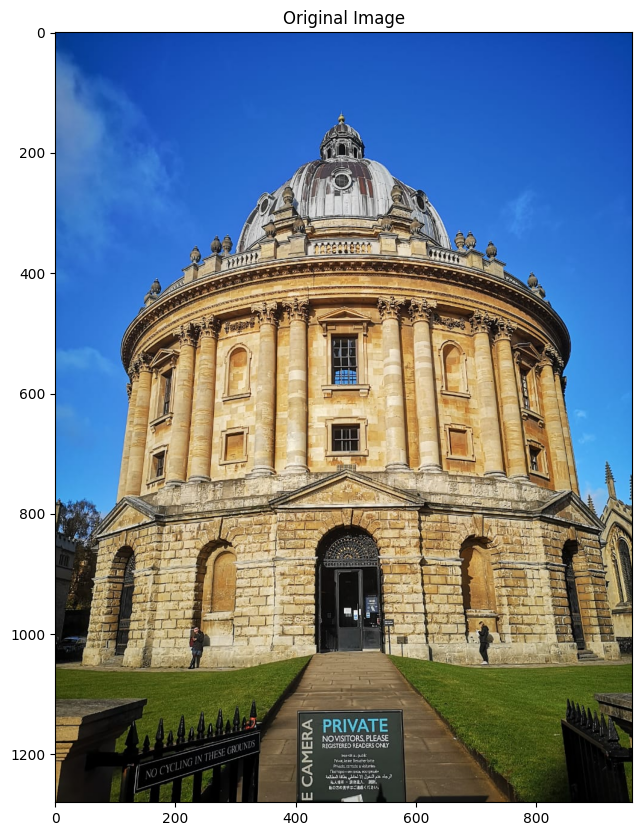

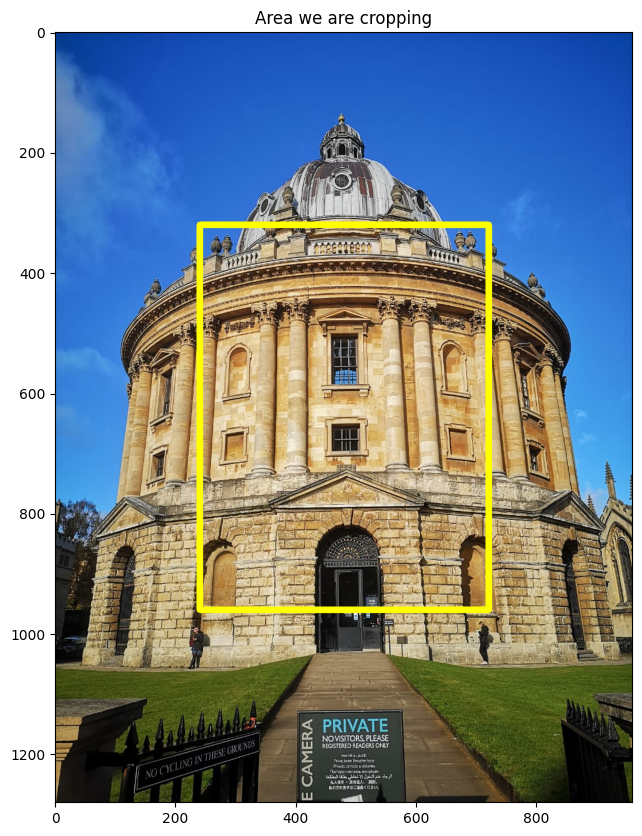

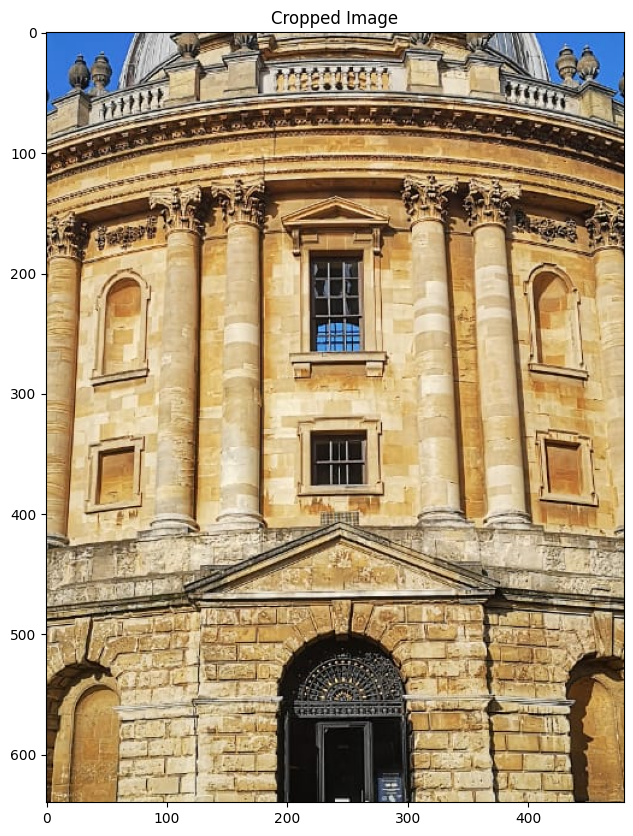

In [73]:
# Get our image dimensions
height, width = image.shape[:2]

# Let's get the starting pixel coordiantes (top  left of cropping rectangle)
# using 0.25 to get the x,y position that is 1/4 down from the top left (0,0)
start_row, start_col = int(height * .25), int(width * .25)

# Let's get the ending pixel coordinates (bottom right)
end_row, end_col = int(height * .75), int(width * .75)

# Simply use indexing to crop out the rectangle we desire
cropped = image[start_row:end_row , start_col:end_col]

imshow("Original Image", image)

# The cv2.rectangle function draws a rectangle over our image (in-place operation)
copy = image.copy()
cv2.rectangle(copy, (start_col,start_row), (end_col,end_row), (0,255,255), 10)

imshow("Area we are cropping", copy)

imshow("Cropped Image", cropped) 

#Airthmetic operations

Operations to directly add or subtract to color intensity. 

Calculates the per-element operation of 2 arrays. The overall effect is increasing or decreasing brightness. 

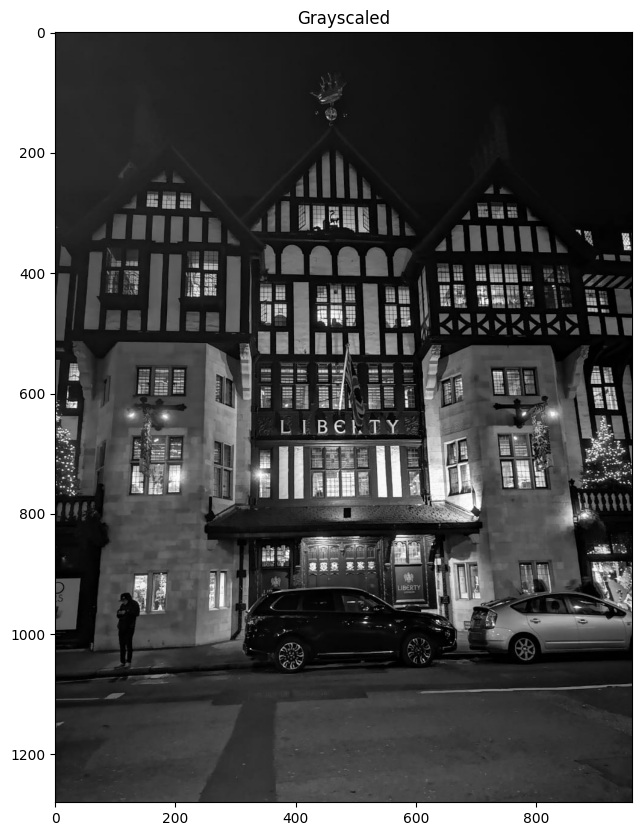

In [75]:
image = cv2.imread("/content/images/liberty.jpeg", 0)
imshow("Grayscaled", image)

In [76]:
#create a matrix of ones, then multiply it by a scaler of 100
# this gives a matrix with same dimensions of our image with all values being 100

N = np.ones(image.shape, dtype = 'uint8')*100

In [78]:
N.shape, N

((1280, 960),
 array([[100, 100, 100, ..., 100, 100, 100],
        [100, 100, 100, ..., 100, 100, 100],
        [100, 100, 100, ..., 100, 100, 100],
        ...,
        [100, 100, 100, ..., 100, 100, 100],
        [100, 100, 100, ..., 100, 100, 100],
        [100, 100, 100, ..., 100, 100, 100]], dtype=uint8))

**Increasing Brightness**

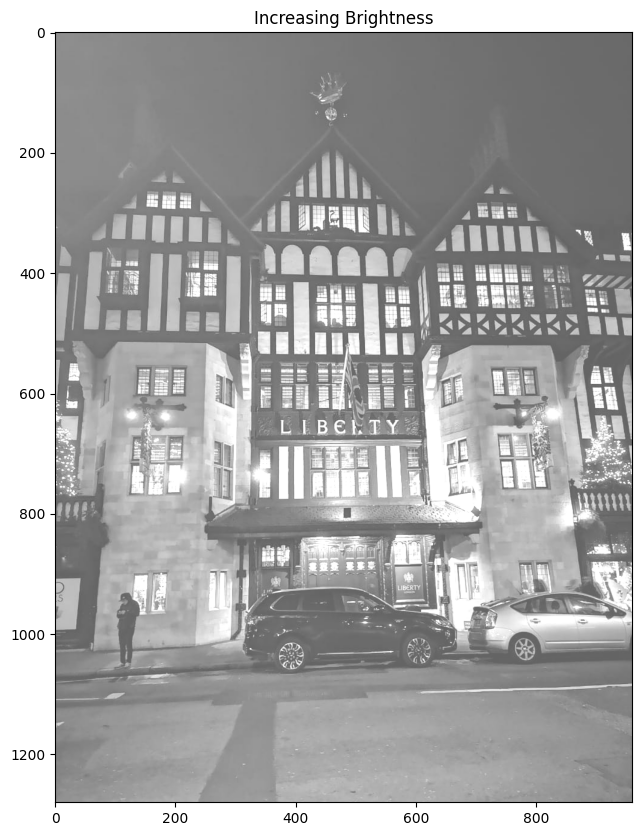

In [79]:
added = cv2.add(image, N)
imshow("Increasing Brightness", added)

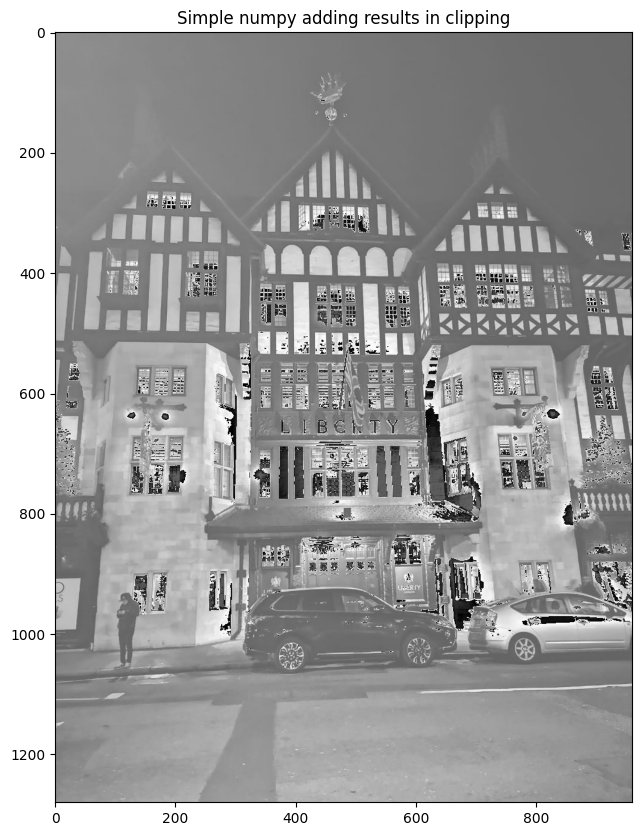

In [80]:
#simply adding it 
added2 = image + N
imshow("Simple numpy adding results in clipping", added2)

**Decreasing Brightness**

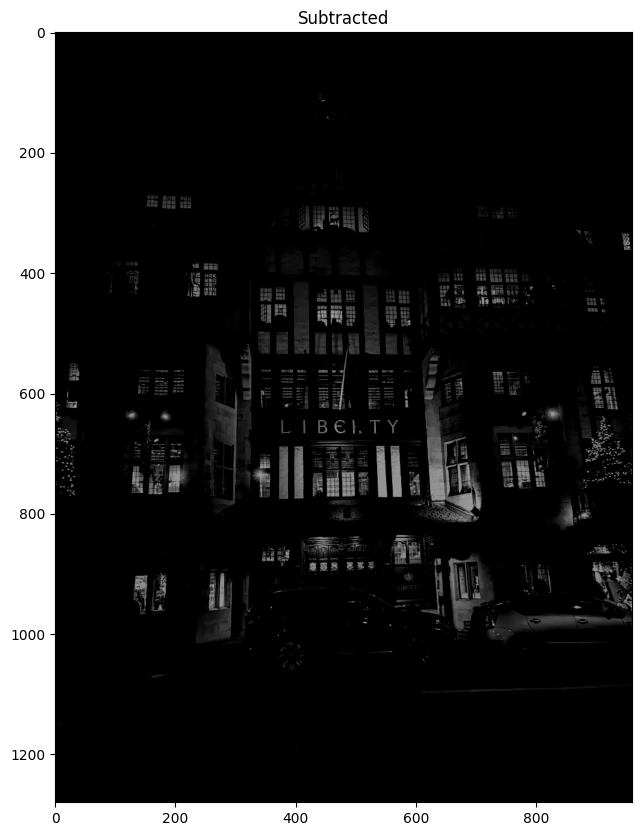

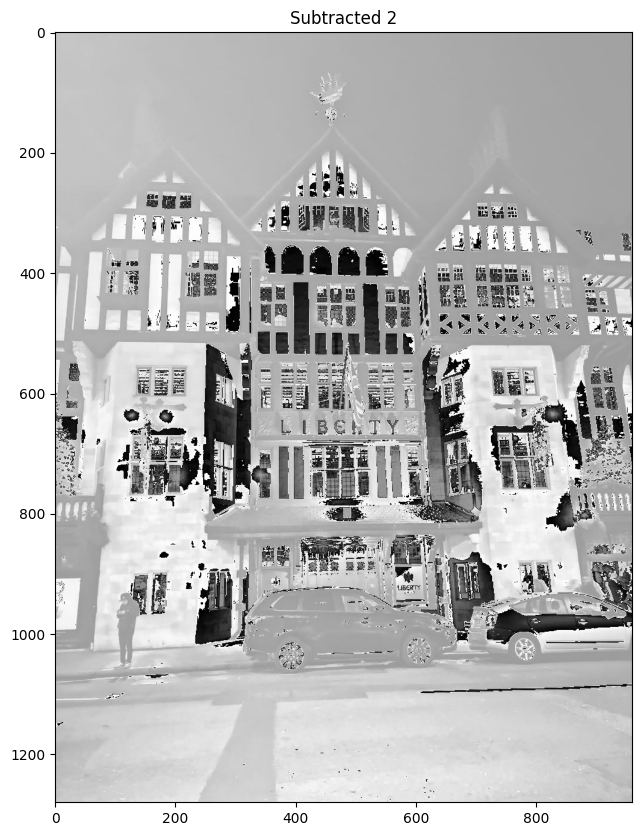

In [82]:
# Likewise we can also subtract
# Notice the decrease in brightness
subtracted = cv2.subtract(image, N)
imshow("Subtracted", subtracted)

subtracted = image - N
imshow("Subtracted 2", subtracted)

#Bitwise operations and masking

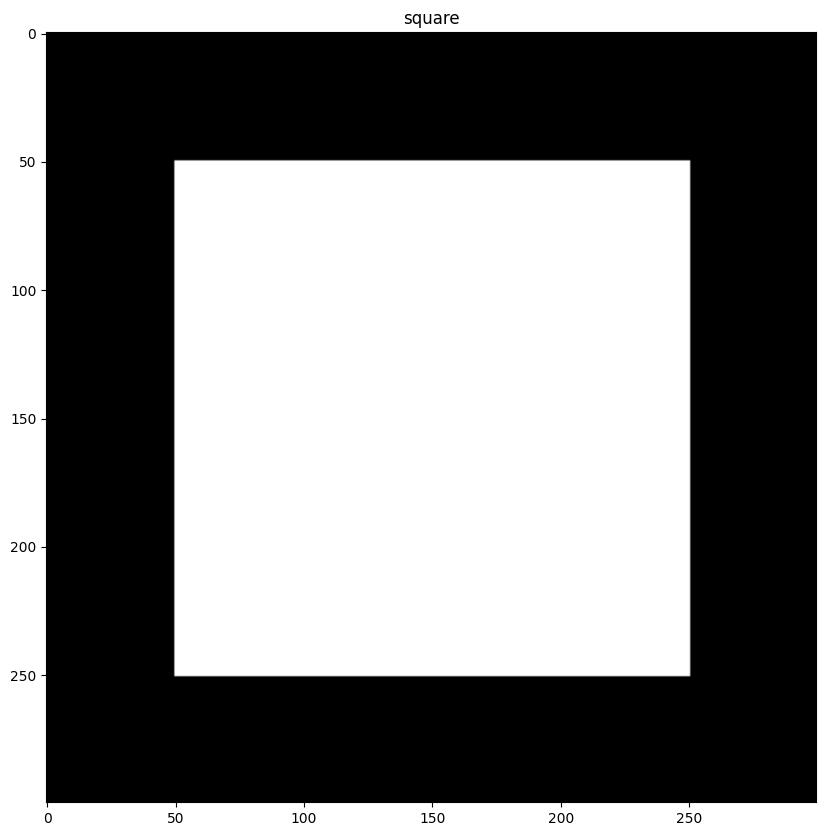

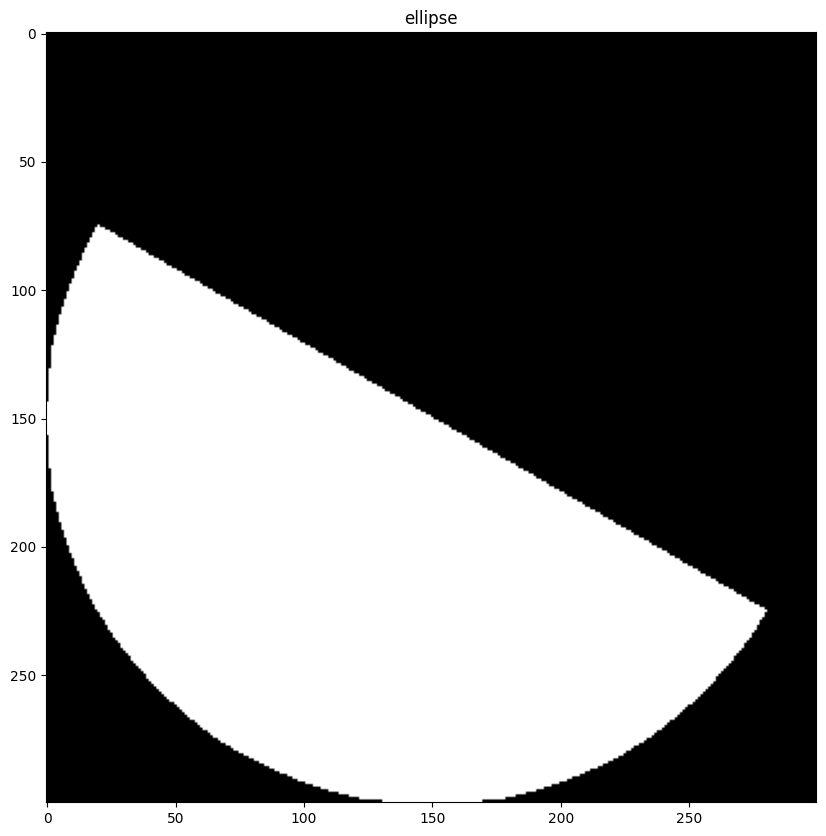

In [83]:
#making a sqaure 
square = np.zeros((300,300), np.uint8)
cv2.rectangle(square, (50,50), (250,250), 255, -2)
imshow("square", square)

# Making a ellipse
ellipse = np.zeros((300, 300), np.uint8)
cv2.ellipse(ellipse, (150, 150), (150, 150), 30, 0, 180, 255, -1)
imshow("ellipse", ellipse)

**Experimenting with some bitwise operations such as AND, OR, XOR and NOT**

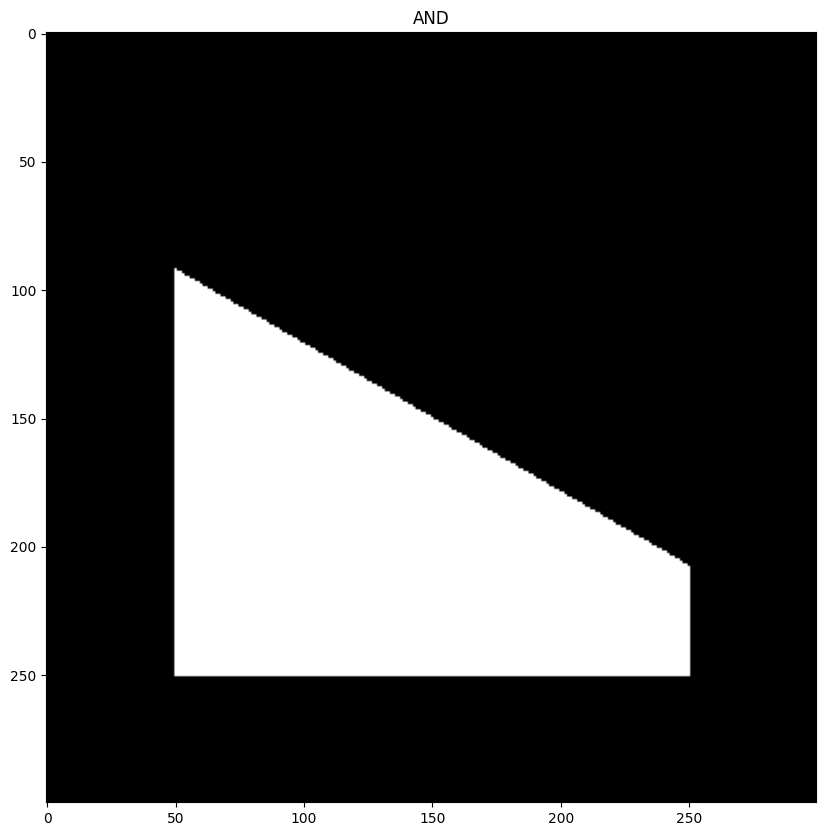

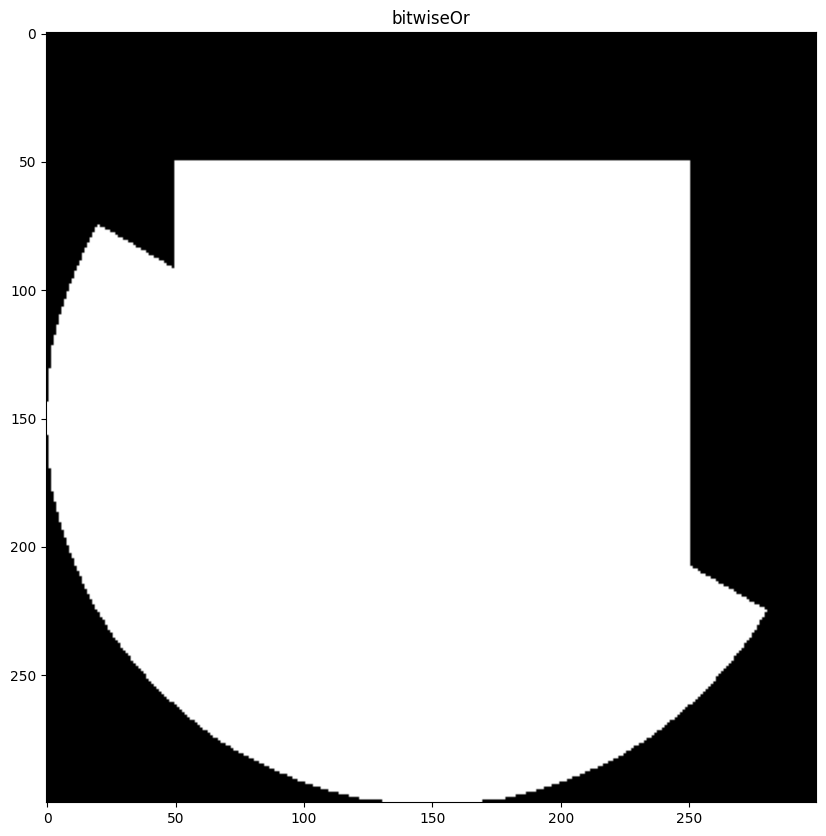

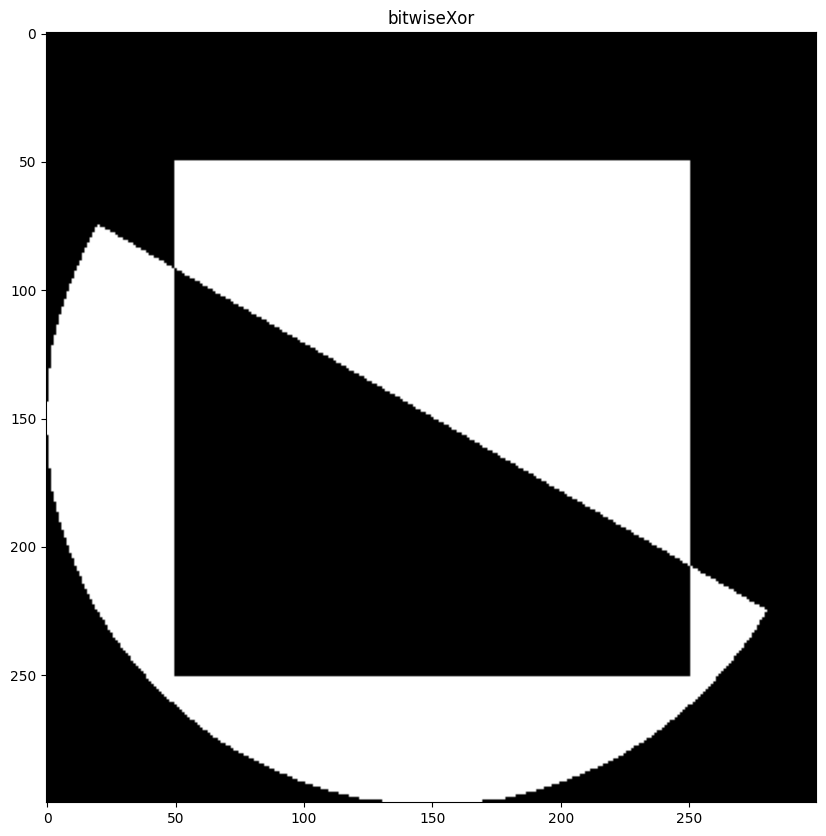

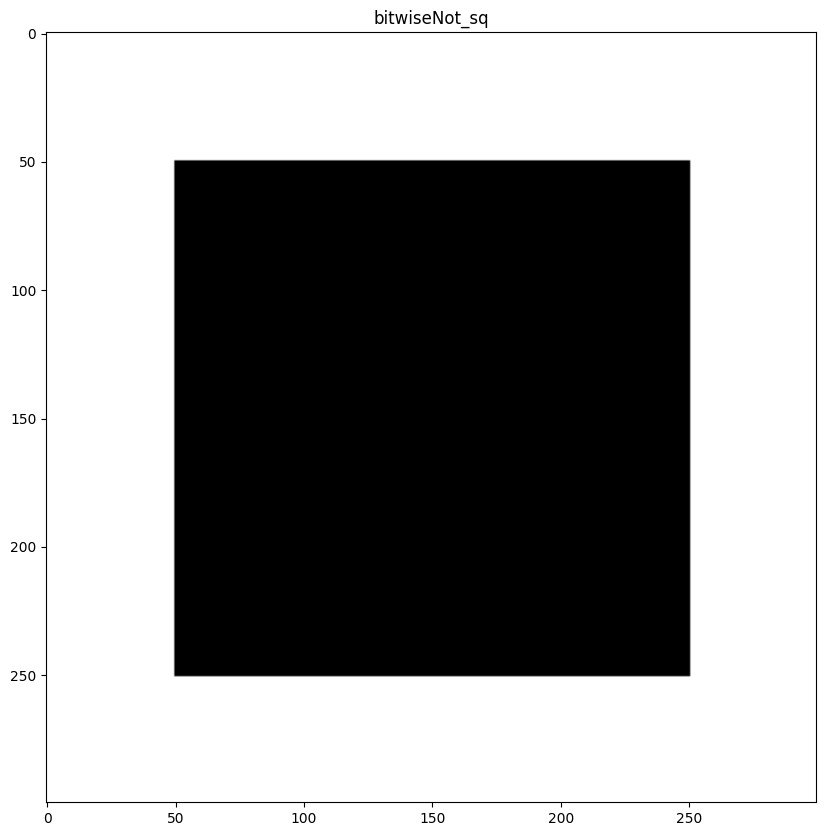

In [84]:
# Shows only where they intersect
And = cv2.bitwise_and(square, ellipse)
imshow("AND", And)

# Shows where either square or ellipse is 
bitwiseOr = cv2.bitwise_or(square, ellipse)
imshow("bitwiseOr", bitwiseOr)

# Shows where either exist by itself
bitwiseXor = cv2.bitwise_xor(square, ellipse)
imshow("bitwiseXor", bitwiseXor)

# Shows everything that isn't part of the square
bitwiseNot_sq = cv2.bitwise_not(square)
imshow("bitwiseNot_sq", bitwiseNot_sq)

# Convolutions, Blurring and Sharpening Images

**Blurring using Convolutions**

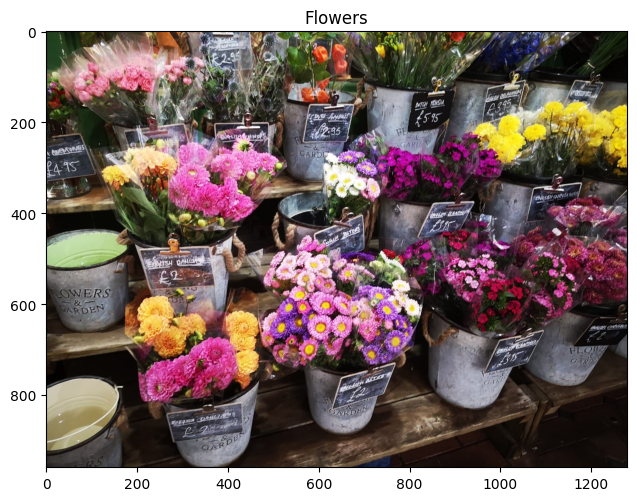

In [85]:
imshow("Flowers", flowers)

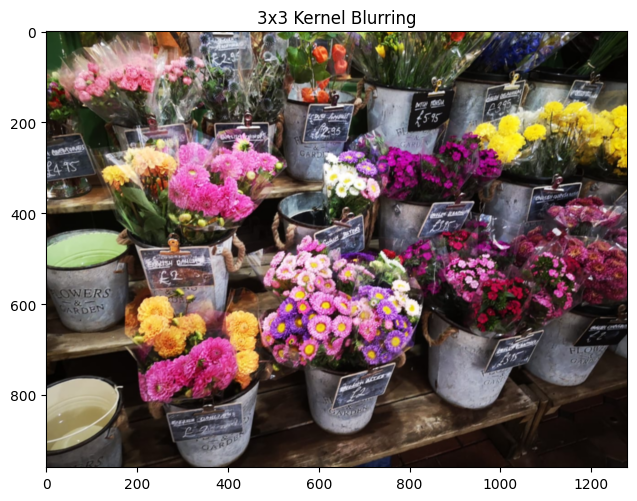

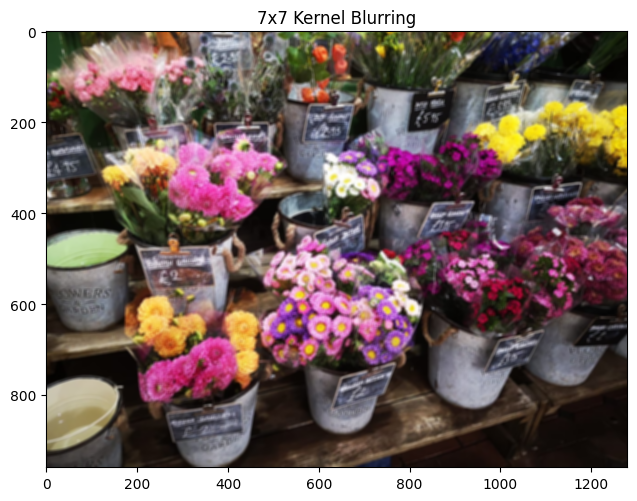

In [86]:
# Creating our 3 x 3 kernel
kernel_3x3 = np.ones((3, 3), np.float32) / 9

# We use the cv2.fitler2D to conovlve the kernal with an image 
blurred = cv2.filter2D(flowers, -1, kernel_3x3)
imshow('3x3 Kernel Blurring', blurred)

# Creating our 7 x 7 kernel
kernel_7x7 = np.ones((7, 7), np.float32) / 49

blurred2 = cv2.filter2D(flowers, -1, kernel_7x7)
imshow('7x7 Kernel Blurring', blurred2)

### Other commonly used blurring methods in open cv
- Regular blurring 
- Gaussian blurring 
- Median Blurring 

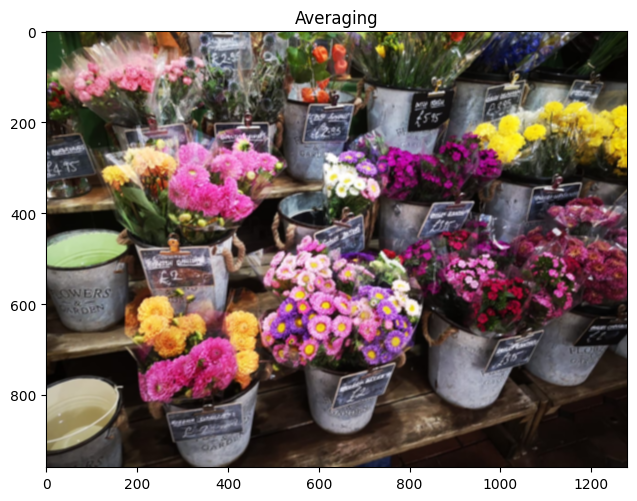

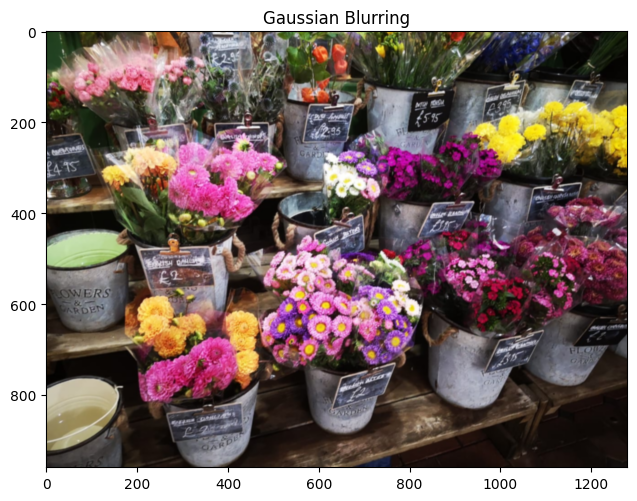

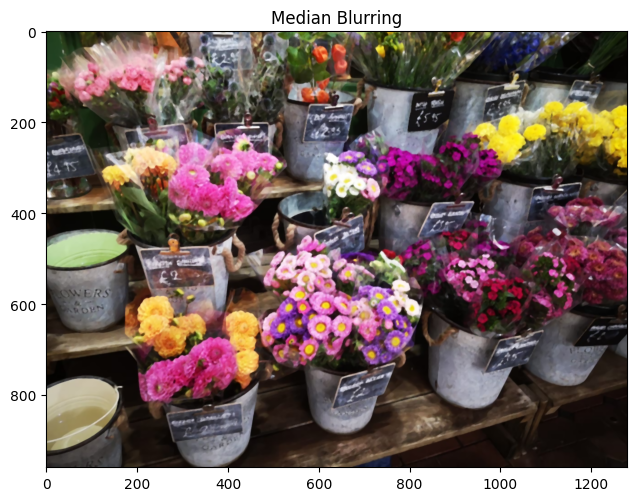

In [88]:
# Averaging done by convolving the image with a normalized box filter. 
# This takes the pixels under the box and replaces the central element
# Box size needs to odd and positive 
blur = cv2.blur(flowers, (5,5))
imshow('Averaging', blur)

# Instead of box filter, gaussian kernel
Gaussian = cv2.GaussianBlur(flowers, (5,5), 0)
imshow('Gaussian Blurring', Gaussian)

# Takes median of all the pixels under kernel area and central 
# element is replaced with this median value
median = cv2.medianBlur(flowers, 5)
imshow('Median Blurring', median)

### **Bilateral Filter**
#### ```dst = cv.bilateralFilter(src, d, sigmaColor, sigmaSpace[, dst[, borderType]])```

**Bilateral is very effective in noise removal while keeping edges sharp**

- **src**	Source 8-bit or floating-point, 1-channel or 3-channel image.
- **dst**	Destination image of the same size and type as src .
- **d**	Diameter of each pixel neighborhood that is used during filtering. If it is non-positive, it is computed from sigmaSpace.
- **sigmaColor**	Filter sigma in the color space. A larger value of the parameter means that farther colors within the pixel neighborhood (see sigmaSpace) will be mixed together, resulting in larger areas of semi-equal color.
- **sigmaSpace**	Filter sigma in the coordinate space. A larger value of the parameter means that farther pixels will influence each other as long as their colors are close enough (see sigmaColor ). When d>0, it specifies the neighborhood size regardless of sigmaSpace. Otherwise, d is proportional to sigmaSpace.
- **borderType**	border mode used to extrapolate pixels outside of the image

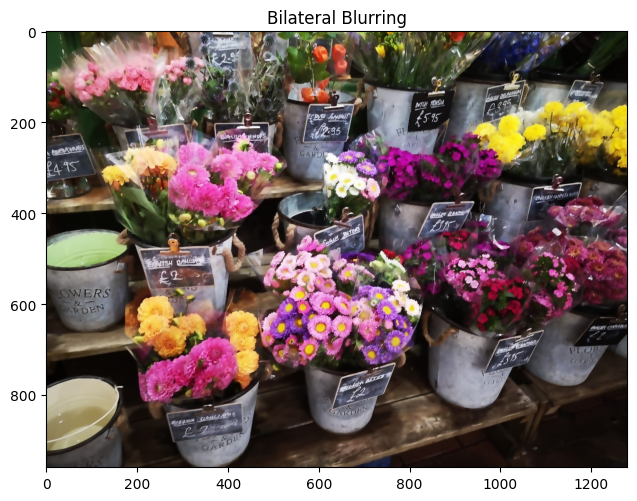

In [89]:
bilateral = cv2.bilateralFilter(flowers, 9, 75, 75)
imshow('Bilateral Blurring', bilateral)

## **Image De-noising - Non-Local Means Denoising**

**There are 4 variations of Non-Local Means Denoising:**

- cv2.fastNlMeansDenoising() - works with a single grayscale images
- cv2.fastNlMeansDenoisingColored() - works with a color image.
- cv2.fastNlMeansDenoisingMulti() - works with image sequence captured in short period of time (grayscale images)
- cv2.fastNlMeansDenoisingColoredMulti() - same as above, but for color images.

```fastNlMeansDenoisingColored(InputArray src, OutputArray dst, float h=3, float hColor=3, int templateWindowSize=7, int searchWindowSize=21 )¶```

#### Parameters for fastNlMeansDenoisingColored:	

- **src** – Input 8-bit 3-channel image.
- **dst** – Output image with the same size and type as src .
templateWindowSize – Size in pixels of the template patch that is used to compute weights. Should be odd. Recommended value 7 pixels
- **searchWindowSize** – Size in pixels of the window that is used to compute weighted average for given pixel. Should be odd. Affect performance linearly: greater searchWindowsSize - greater denoising time. Recommended value 21 pixels
- **h** – Parameter regulating filter strength for luminance component. Bigger h value perfectly removes noise but also removes image details, smaller h value preserves details but also preserves some noise
- **hColor** – The same as h but for color components. For most images value equals 10 will be enought to remove colored noise and do not distort colors

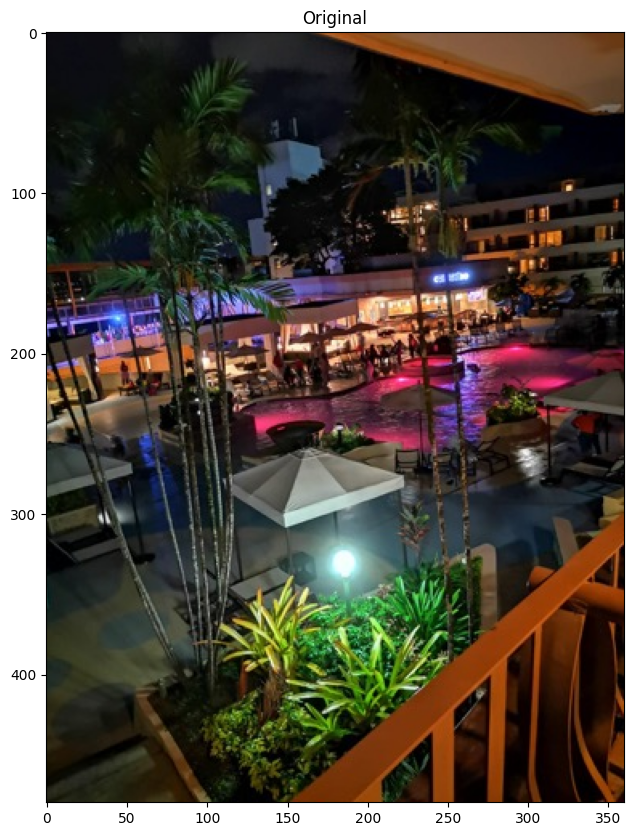

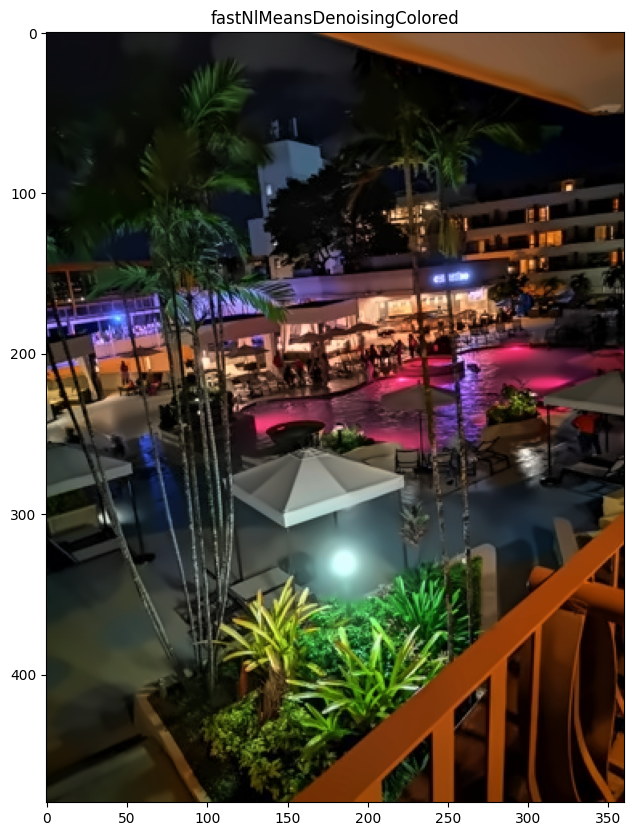

In [90]:
image = cv2.imread('/content/images/hilton.jpeg')
imshow('Original', image)

dst = cv2.fastNlMeansDenoisingColored(image, None, 6, 6, 7, 21)
imshow('fastNlMeansDenoisingColored', dst)

### Sharpening Images

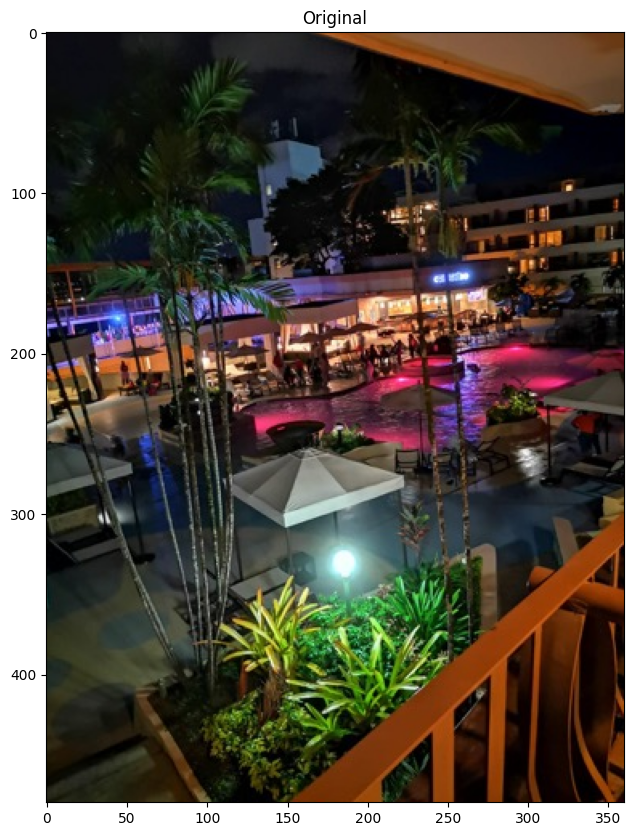

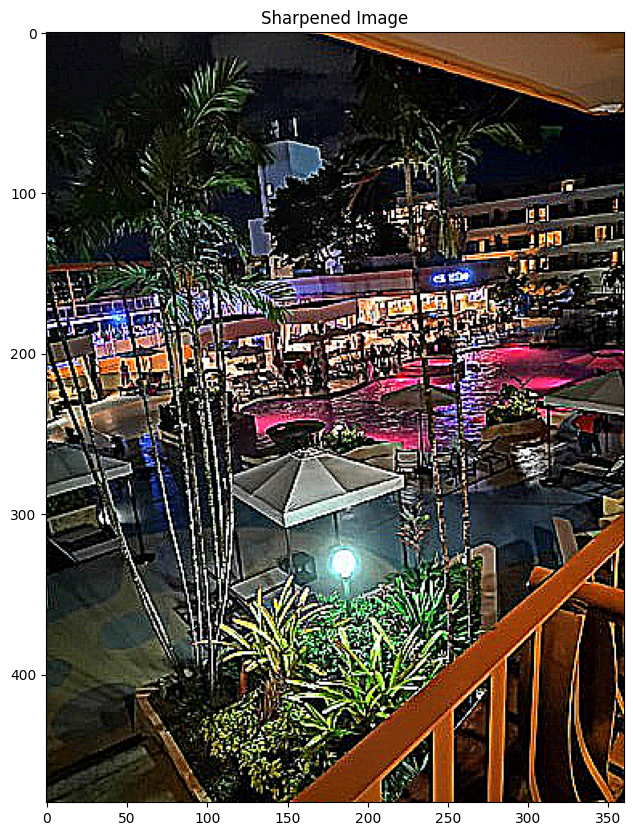

In [91]:
# Loading our image
imshow('Original', image)
# Create our shapening kernel, remember it must sum to one 
kernel_sharpening = np.array([[-1,-1,-1], 
                              [-1, 9,-1],
                              [-1,-1,-1]])

# applying the sharpening kernel to the image
sharpened = cv2.filter2D(image, -1, kernel_sharpening)
imshow('Sharpened Image', sharpened)

#Thresholding

### **Thresholding Methods** 

![](https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/Screenshot%202020-11-17%20at%2012.57.55%20am.png)
![](https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/Screenshot%202020-11-17%20at%2012.58.09%20am.png)


https://docs.opencv.org/master/d7/d4d/tutorial_py_thresholding.html


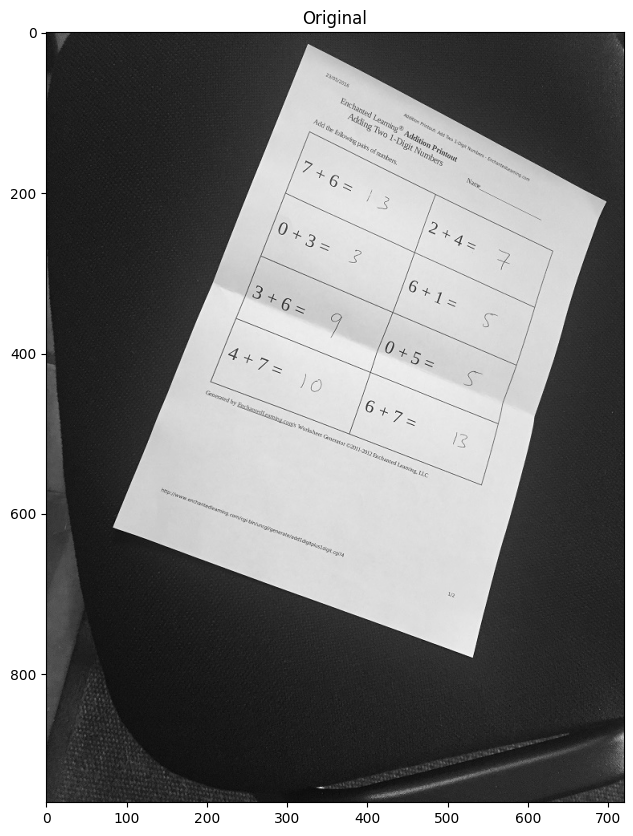

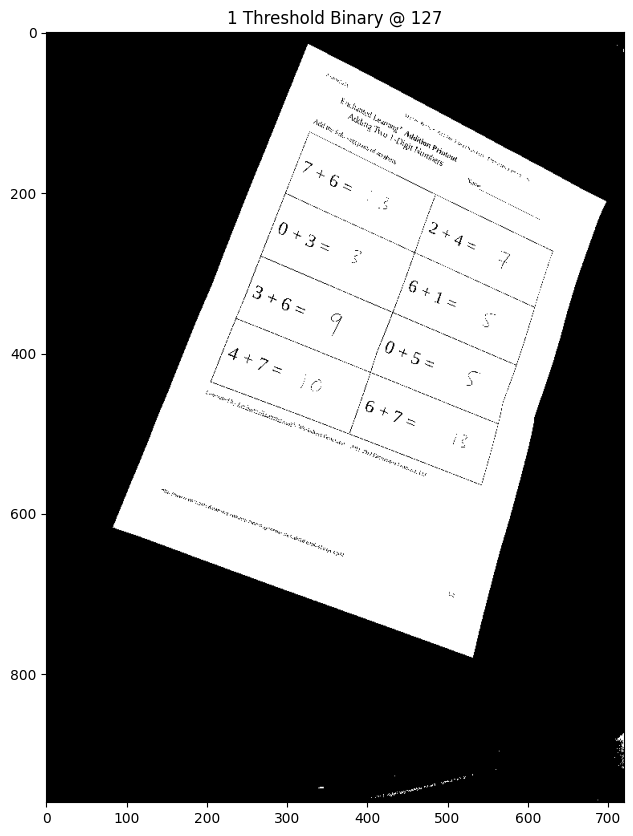

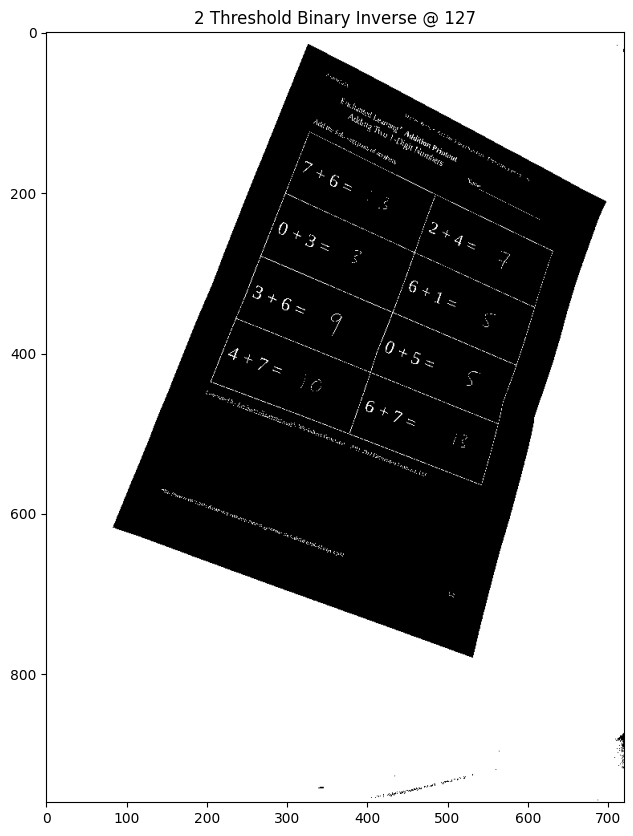

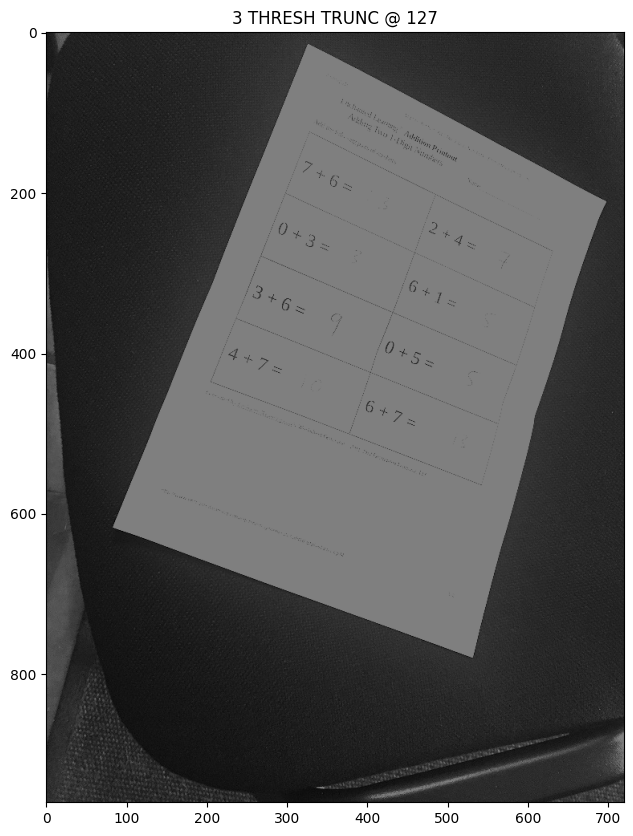

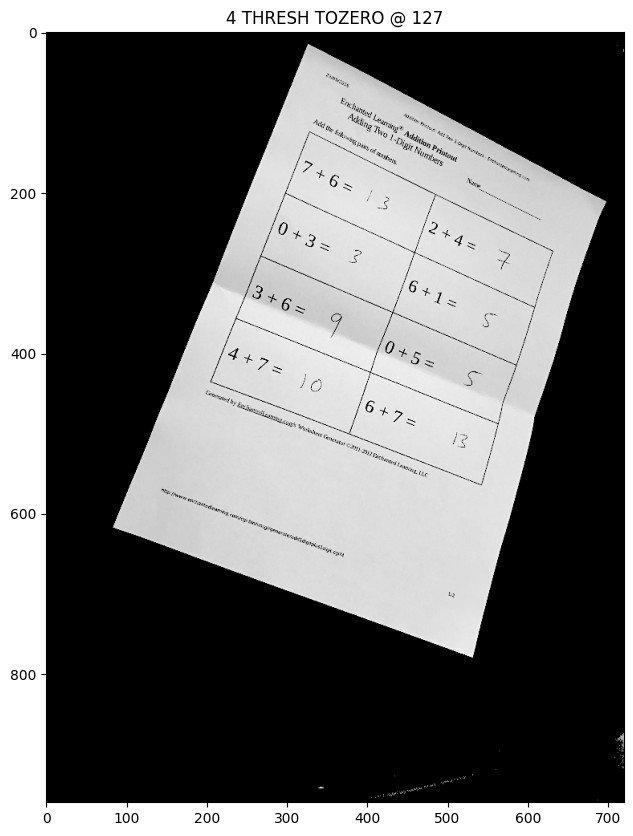

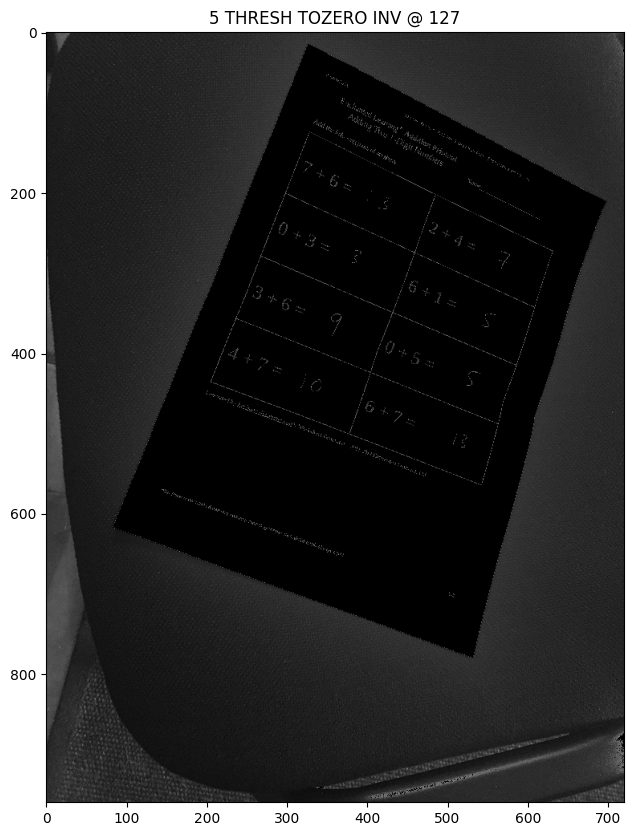

In [93]:
# Load our image as greyscale 
image = cv2.imread('/content/images/scan.jpg',0)
imshow("Original", image)

# Values below 127 goes to 0 or black, everything above goes to 255 (white)
ret,thresh1 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
imshow('1 Threshold Binary @ 127', thresh1)

# Values below 127 go to 255 and values above 127 go to 0 (reverse of above)
ret,thresh2 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY_INV)
imshow('2 Threshold Binary Inverse @ 127', thresh2)

# Values above 127 are truncated (held) at 127 (the 255 argument is unused)
ret,thresh3 = cv2.threshold(image, 127, 255, cv2.THRESH_TRUNC)
imshow('3 THRESH TRUNC @ 127', thresh3)

# Values below 127 go to 0, above 127 are unchanged  
ret,thresh4 = cv2.threshold(image, 127, 255, cv2.THRESH_TOZERO)
imshow('4 THRESH TOZERO @ 127', thresh4)

# Reverse of the above, below 127 is unchanged, above 127 goes to 0
ret,thresh5 = cv2.threshold(image, 127, 255, cv2.THRESH_TOZERO_INV)
imshow('5 THRESH TOZERO INV @ 127', thresh5)

#### **Adaptive Thresholding**

1. ADAPTIVE_THRESH_MEAN_C
2. THRESH_OTSU

#### **cv2.adaptiveThreshold Parameters**

``**cv2.adaptiveThreshold**(src, maxValue, adaptiveMethod, thresholdType, blockSize, C[, dst]) → dst``

- **src** – Source 8-bit single-channel image.
- **dst** – Destination image of the same size and the same type as src .
- **maxValue** – Non-zero value assigned to the pixels for which the condition is satisfied. See the details below.
- **adaptiveMethod** – Adaptive thresholding algorithm to use, ADAPTIVE_THRESH_MEAN_C or ADAPTIVE_THRESH_GAUSSIAN_C . See the details below.
- **thresholdType** – Thresholding type that must be either THRESH_BINARY or THRESH_BINARY_INV .
- **blockSize** – Size of a pixel neighborhood that is used to calculate a threshold value for the pixel: 3, 5, 7, and so on.
- **C** – Constant subtracted from the mean or weighted mean. Normally, it is positive but may be zero or negative as well.


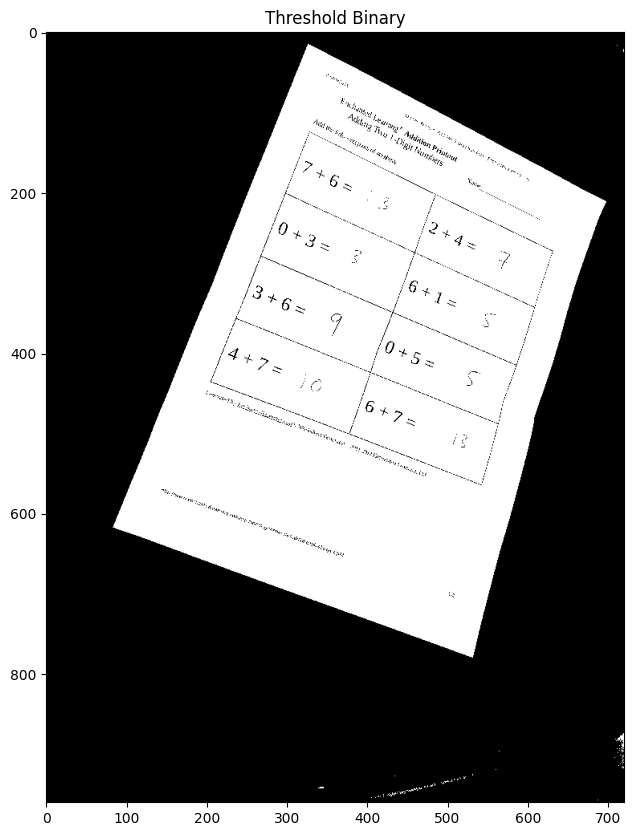

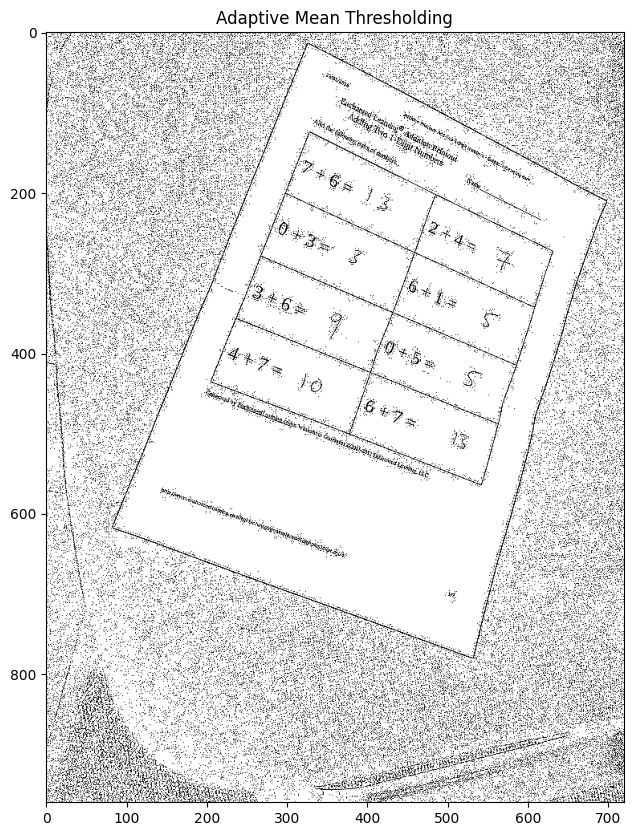

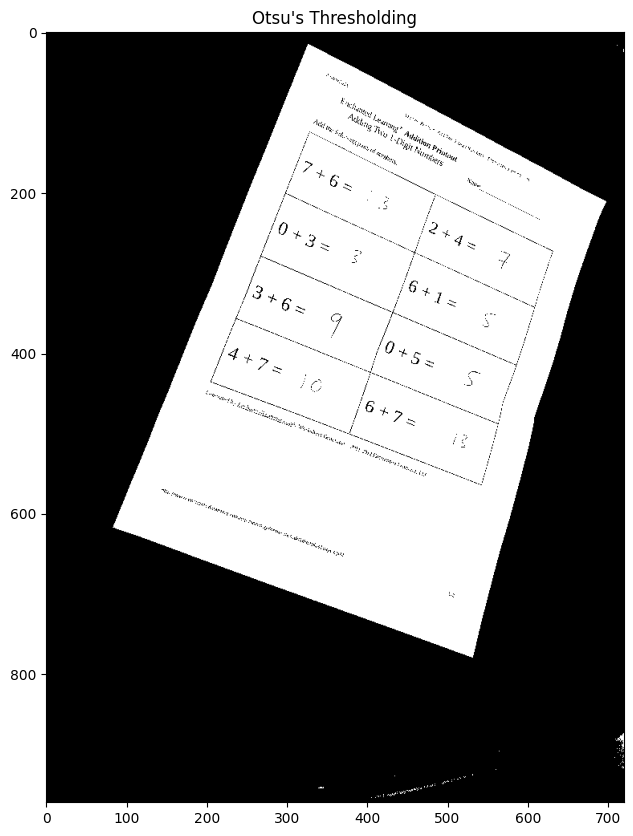

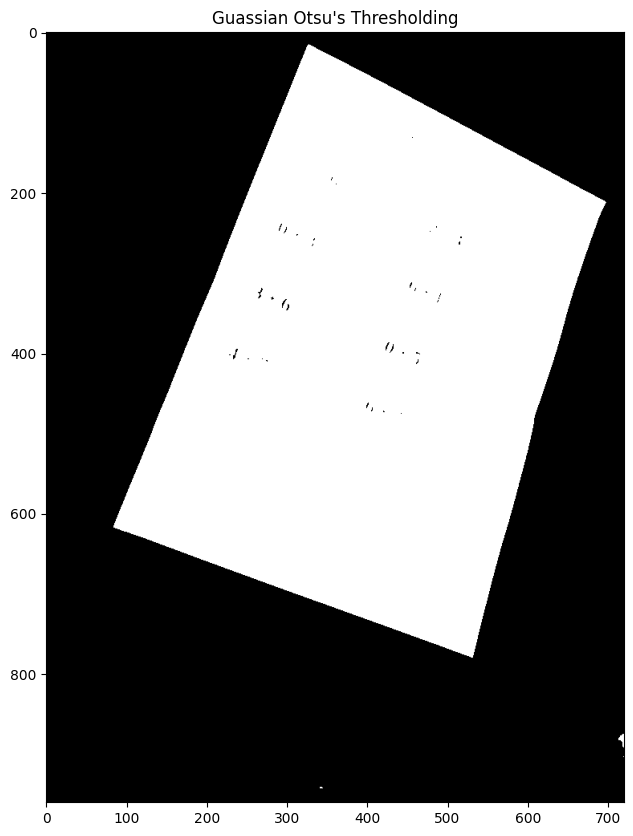

In [96]:
image = cv2.imread('/content/images/scan.jpg',0)


# Values below 127 goes to 0 (black, everything above goes to 255 (white)
ret,thresh1 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
imshow('Threshold Binary', thresh1)

# It's good practice to blur images as it removes noise
#image = cv2.GaussianBlur(image, (3, 3), 0)

# Using adaptiveThreshold
thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 3, 5) 
imshow("Adaptive Mean Thresholding", thresh) 

_, th2 = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imshow("Otsu's Thresholding", th2) 

# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(image, (5,5), 0)
_, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imshow("Guassian Otsu's Thresholding", th3) 

### **SkImage Threshold Local**


``threshold_local(image, block_size, offset=10)``

The threshold_local function, calculates thresholds in regions with a characteristic size ``block_size`` surrounding each pixel (i.e. local neighborhoods). Each threshold value is the weighted mean of the local neighborhood minus an ``offset`` value


https://scikit-image.org/docs/stable/auto_examples/applications/plot_thresholding.html

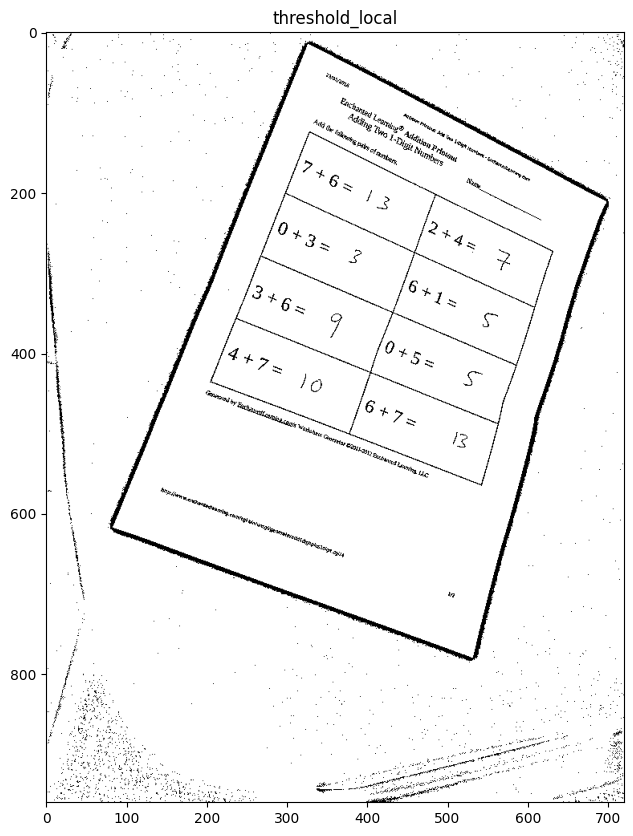

In [97]:
from skimage.filters import threshold_local
image = cv2.imread('/content/images/scan.jpg')


# We get the Value component from the HSV color space 
# then we apply adaptive thresholdingto 
V = cv2.split(cv2.cvtColor(image, cv2.COLOR_BGR2HSV))[2]
T = threshold_local(V, 25, offset=15, method="gaussian")

# Apply the threshold operation 
thresh = (V > T).astype("uint8") * 255
imshow("threshold_local", thresh)

#Dilation, Erosion and Edge Detection 

- **Dilation** – Adds pixels to the boundaries of objects in an image
- **Erosion** – Removes pixels at the boundaries of objects in an image
- **Opening** - Erosion followed by dilation
- **Closing** - Dilation followed by erosion 

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/Screenshot%202021-11-15%20at%205.19.08%20pm.png)

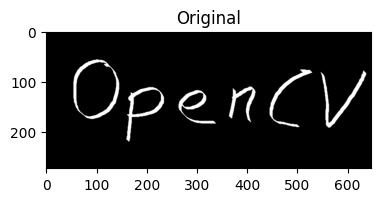

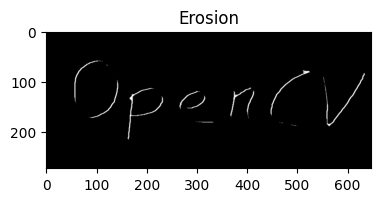

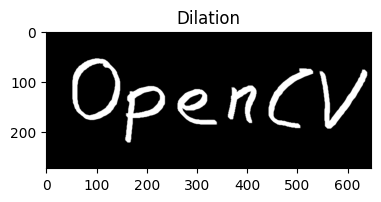

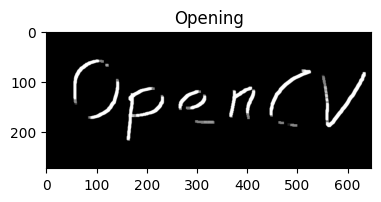

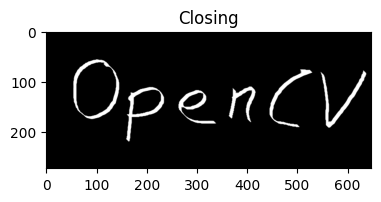

In [99]:
image = cv2.imread('/content/images/opencv_inv.png', 0)
imshow('Original', image)

# Let's define our kernel size
kernel = np.ones((5,5), np.uint8)

# Now we erode
erosion = cv2.erode(image, kernel, iterations = 1)
imshow('Erosion', erosion)

# Dilate here
dilation = cv2.dilate(image, kernel, iterations = 1)
imshow('Dilation', dilation)

# Opening - Good for removing noise
opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
imshow('Opening',opening)

# Closing - Good for removing noise
closing = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
imshow('Closing',closing)

## **Canny Edge Detection** 
![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/Screenshot%202021-11-15%20at%205.24.15%20pm.png)

- The first argument is our input image.
- The second and third arguments are our minVal and maxVal respectively. 
- The forth argument is aperture_size. It is the size of Sobel kernel used for find image gradients. By default it is 3. 

Edge detection needs a threshold to tell what difference/change should be counted as edge

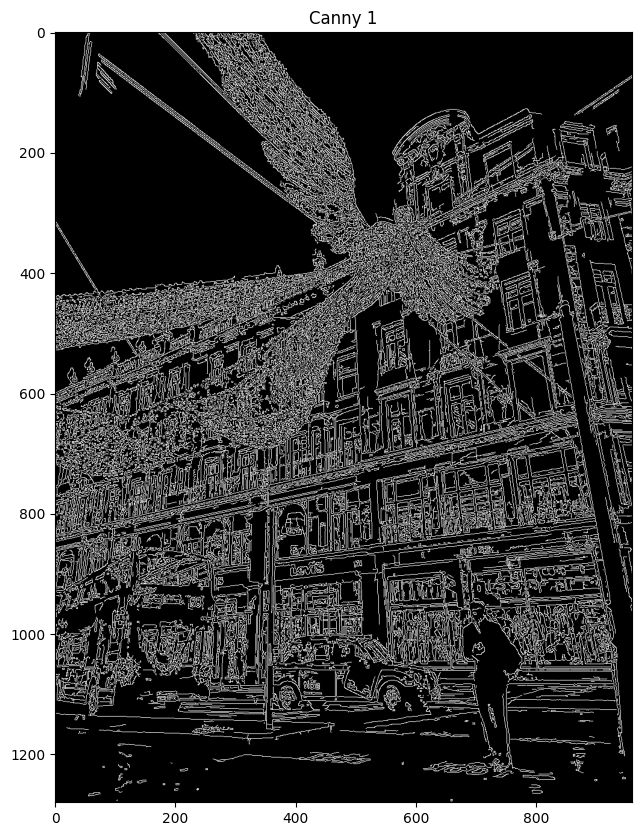

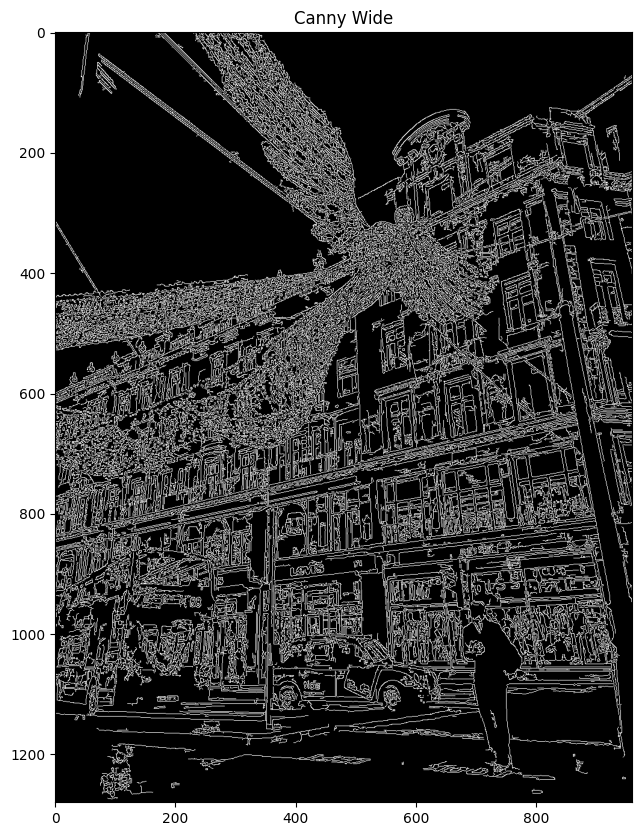

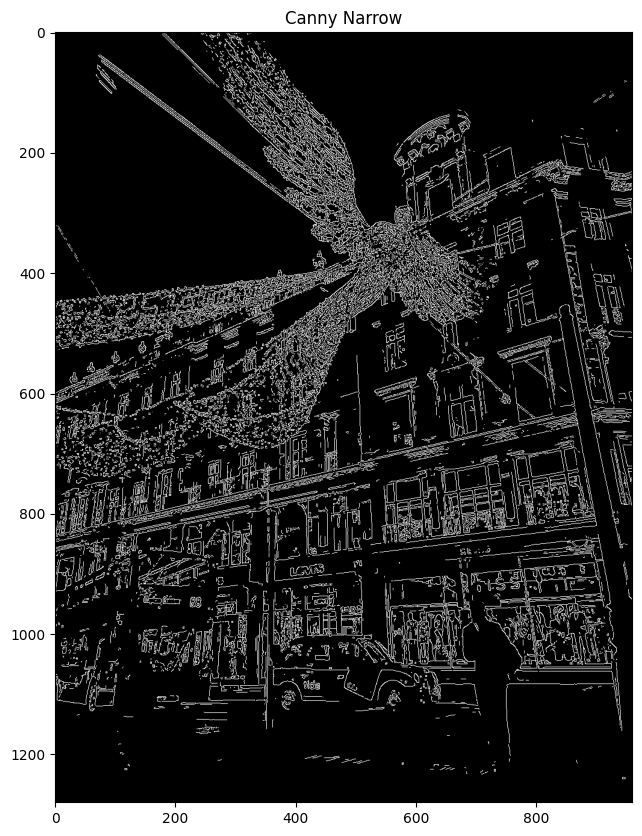

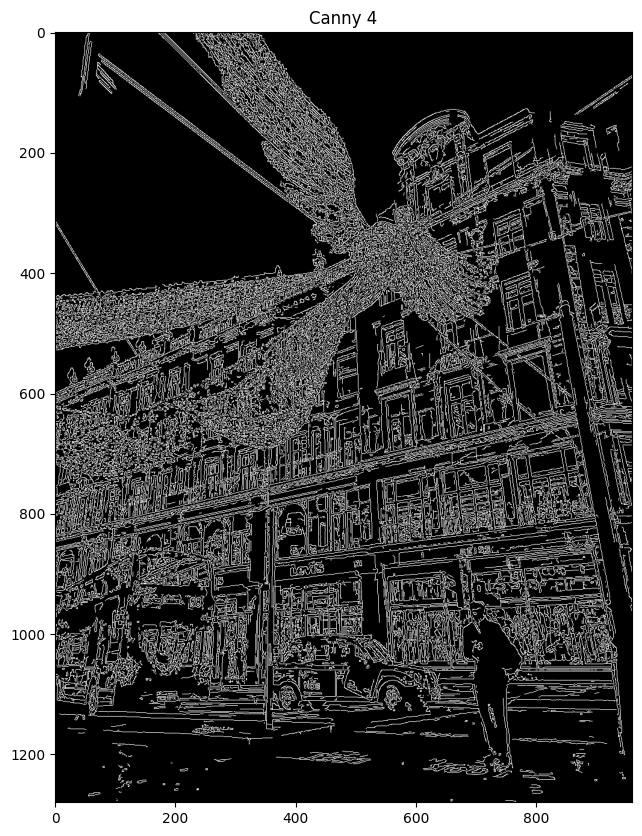

In [100]:
image = cv2.imread('/content/images/londonxmas.jpeg',0)

# Canny Edge Detection uses gradient values as thresholds
# The first threshold gradient
canny = cv2.Canny(image, 50, 120)
imshow('Canny 1', canny)

# Wide edge thresholds expect lots of edges
canny = cv2.Canny(image, 10, 200)
imshow('Canny Wide', canny)

# Narrow threshold, expect less edges 
canny = cv2.Canny(image, 200, 240)
imshow('Canny Narrow', canny)

canny = cv2.Canny(image, 60, 110)
imshow('Canny 4', canny)

##  Then, we need to provide two values: threshold1 and threshold2. Any gradient value larger than threshold2
# is considered to be an edge. Any value below threshold1 is considered not to be an edge. 
#Values in between threshold1 and threshold2 are either classiﬁed as edges or non-edges based on how their 
#intensities are “connected”. In this case, any gradient values below 60 are considered non-edges
#whereas any values above 120 are considered edges.

##Auto canny

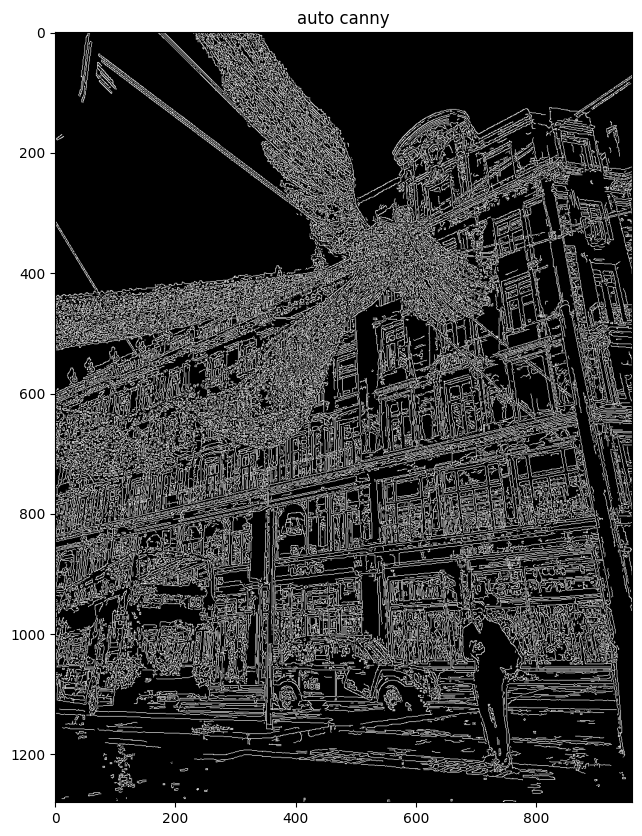

In [101]:
def autoCanny(image):
  # Finds optimal thresholds based on median image pixel intensity
  blurred_img = cv2.blur(image, ksize=(5,5))
  med_val = np.median(image) 
  lower = int(max(0, 0.66 * med_val))
  upper = int(min(255, 1.33 * med_val))
  edges = cv2.Canny(image=image, threshold1=lower, threshold2=upper)
  return edges

auto_canny = autoCanny(image)
imshow("auto canny", auto_canny)